<a href="https://colab.research.google.com/github/zubaerimran/219_projs/blob/master/code/gan/gan_pneu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Semi-Supervised Learning GAN - MNIST dataset

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
import numpy as np
import time
import os
import pdb

import tensorflow as tf
from tensorflow.contrib.layers.python.layers import batch_norm

from sklearn.metrics import roc_auc_score

from matplotlib import pyplot as plt
#%matplotlib inline

Initialization

In [0]:
x_height, x_width = [64, 64]
num_channels = 1
num_classes = 3
latent_size = 128
labeled_rate = 0.1
g_scale_factor = 1 - 0.75/2
d_scale_factor = 0.25
eps_min = 1e-8 # used to avoid NAN loss
eps_max = 1.0
alpha = 0.2

save_to = 'gdrive/My Drive/gan/pneu/model_Jan17/out/'

if not os.path.exists(save_to):
    os.makedirs(save_to)

log_path = 'gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_log.csv'
model_path ='gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt'

In [0]:
# norm_tr1 = (norm_tr + 1.0)/2.0
# np.max(norm_tr), np.max(norm_tr1)

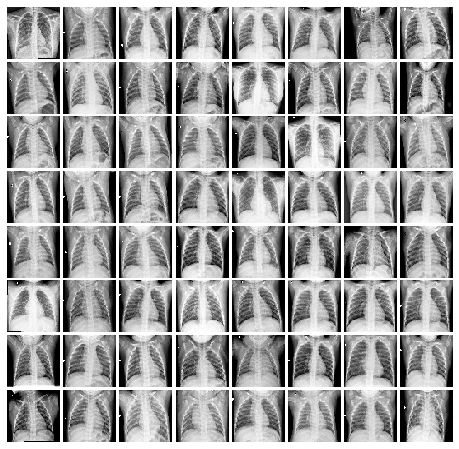

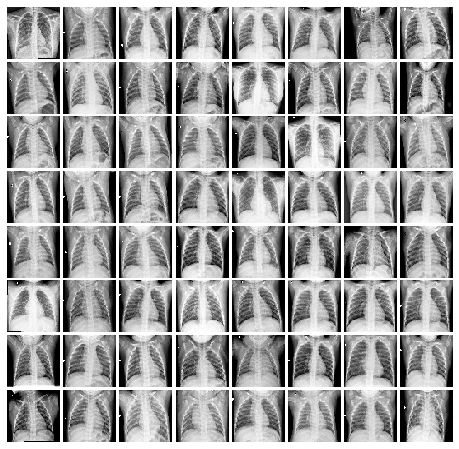

In [15]:
# #checking training data
tr = dataset['x_train']
ntr = normalize(tr)
ntr = (ntr+1)/2
plot(ntr[:64])

In [0]:
def normalize(x):
    # normalize data
    x = (x - 127.5) / 127.5
    return x.reshape((-1, x_height, x_width, num_channels))

In [0]:
import scipy.io as sio
dataset = sio.loadmat('gdrive/My Drive/pneu5216&624.mat')

In [0]:
# plot_fake_data(norm_tr1)

In [0]:
# #checking training data
# tr = dataset['train_images']
# plot(tr[:64])

# norm_tr = normalize(tr)
# norm_tr1 = (norm_tr +1)/2
# plot(norm_tr1[:64])

In [0]:
# def G(inputs, is_training, reuse = False, print_summary = False):
#     with tf.variable_scope('Generator', reuse = reuse) as scope:

#         normal_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
        
#         # Expand input to [batch, 1, 1, channels]
#         inputs = tf.expand_dims(tf.expand_dims(inputs, 1), 1)
        
#         # Transposed convolution outputs [batch, 4, 4, 1024]
#         net = tf.layers.conv2d_transpose(inputs, 
#                                          filters=1024, 
#                                          kernel_size=4, 
#                                          padding='valid',
#                                          kernel_initializer=normal_initializer,
#                                          trainable=is_training,
#                                          name='tconv1')

#         net = tf.layers.batch_normalization(net, 
#                                             training=is_training,
#                                             name='tconv1/batch_normalization')

#         net = tf.nn.relu(net, name='tconv1/relu')
        
#         # Transposed convolution outputs [batch, 8, 8, 256]
#         net = tf.layers.conv2d_transpose(net, 
#                                          filters=256, 
#                                          kernel_size=4, 
#                                          strides=2, 
#                                          padding='same',
#                                          kernel_initializer=normal_initializer,
#                                          trainable=is_training,
#                                          name='tconv2')

#         net = tf.layers.batch_normalization(net, 
#                                             training=is_training,
#                                             name='tconv2/batch_normalization')
#         net = tf.nn.relu(net, name='tconv2/relu')
        
#         # Transposed convolution outputs [batch, 16, 16, 64]
#         net = tf.layers.conv2d_transpose(net, 
#                                          filters=64, 
#                                          kernel_size=4, 
#                                          strides=2, 
#                                          padding='same',
#                                          kernel_initializer=normal_initializer,
#                                          trainable=is_training,
#                                          name='tconv3')

#         net = tf.layers.batch_normalization(net, 
#                                             training=is_training,
#                                             name='tconv3/batch_normalization')
#         net = tf.nn.relu(net, name='tconv3/relu')
        
#         # Transposed convolution outputs [batch, 32, 32, 3]
#         net = tf.layers.conv2d_transpose(net, 
#                                          filters=3, 
#                                          kernel_size=4, 
#                                          strides=2, 
#                                          padding='same',
#                                          kernel_initializer=normal_initializer,
#                                          trainable=is_training,
#                                          name='tconv4')

#         net = tf.tanh(net, name='tconv4/tanh')
        
#         return net

# def D(inputs, dropout_rate, is_training, reuse = True, print_summary = True):

#   with tf.variable_scope('Discriminator', reuse = reuse) as scope:      

#         normal_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
        
#         # Convolution outputs [batch, 16, 16, 64]
#         net = tf.layers.conv2d(inputs, 
#                                filters=64, 
#                                kernel_size=4, 
#                                strides=2, 
#                                padding='same',
#                                kernel_initializer=normal_initializer,
#                                trainable=is_training,
#                                name='conv1')

#         net = leaky_relu(net, 0.2, name='conv1/leaky_relu')
        
#         # Convolution outputs [batch, 8, 8, 256]
#         net = tf.layers.conv2d(net, 
#                                filters=256, 
#                                kernel_size=4, 
#                                strides=2, 
#                                padding='same',
#                                kernel_initializer=normal_initializer,
#                                trainable=is_training,
#                                name='conv2')

#         net = tf.layers.batch_normalization(net, 
#                                             training=is_training,
#                                             name='conv2/batch_normalization')

#         net = leaky_relu(net, 0.2, name='conv2/leaky_relu')
        
#         # Convolution outputs [batch, 4, 4, 1024]
#         net = tf.layers.conv2d(net, 
#                                filters=1024, 
#                                kernel_size=4, 
#                                strides=2, 
#                                padding='same',
#                                kernel_initializer=normal_initializer,
#                                trainable=is_training,
#                                name='conv3')

#         net = tf.layers.batch_normalization(net, 
#                                             training=is_training,
#                                             name='conv3/batch_normalization')

#         net = leaky_relu(net, 0.2, name='conv3/leaky_relu')
        
#         # Convolution outputs [batch, 1, 1, 1]
# #         net = tf.layers.conv2d(net, 
# #                                filters=1, 
# #                                kernel_size=4, 
# #                                padding='valid',
# #                                kernel_initializer=normal_initializer,
# #                                trainable=is_training,
# #                                name='conv4')
        
#         # Squeeze height and width dimensions
#         #net = tf.squeeze(net, [1, 2, 3])
        
#         flatten_length = lrelu4.get_shape().as_list()[1] * \
# #                          lrelu4.get_shape().as_list()[2] * lrelu4.get_shape().as_list()[3]
# #         flatten5 = tf.reshape(lrelu4, (-1, flatten_length)) # used for "Feature Matching" 
# #         fc5 = tf.layers.dense(flatten5, (num_classes + 1))
# #         output = tf.nn.softmax(fc5)

# #         assert output.get_shape()[1:] == [num_classes + 1]

# #         if print_summary:
# #             print('Discriminator summary:\n x: %s\n' \
# #                   ' D1: %s\n D2: %s\n D3: %s\n D4: %s\n' %(x.get_shape(), 
# #                                                            dropout1.get_shape(),
# #                                                            lrelu2.get_shape(), 
# #                                                            dropout3.get_shape(),
# #                                                            lrelu4.get_shape()))
# #         return flatten5, fc5, output

In [0]:
def D(x, dropout_rate, is_training, reuse = True, print_summary = True):
    # discriminator (x -> n + 1 class)

    with tf.variable_scope('Discriminator', reuse = reuse) as scope:
        normal_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
        # layer1 - do not use Batch Normalization on the first layer of Discriminator
        conv1 = tf.layers.conv2d(x, 32, [5, 5],
                                 strides = [2, 2],
                                 padding = 'same',
                                 kernel_initializer=normal_initializer,)
        lrelu1 = tf.maximum(0.2 * conv1, conv1) #leaky relu
        dropout1 = tf.layers.dropout(lrelu1, dropout_rate)

        # layer2
        conv2 = tf.layers.conv2d(dropout1, 64, [3, 3],
                                 strides = [2, 2],
                                 padding = 'same',
                                 kernel_initializer=normal_initializer)
        batch_norm2 = tf.layers.batch_normalization(conv2, training = is_training)
        lrelu2 = tf.maximum(0.2 * batch_norm2, batch_norm2)

        # layer3
        conv3 = tf.layers.conv2d(lrelu2, 128, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same',
                                 kernel_initializer=normal_initializer)
        batch_norm3 = tf.layers.batch_normalization(conv3, training = is_training)
        lrelu3 = tf.maximum(0.2 * batch_norm3, batch_norm3)
        dropout3 = tf.layers.dropout(lrelu3, dropout_rate)

        # layer 4
        conv4 = tf.layers.conv2d(dropout3, 256, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same',
                                 kernel_initializer=normal_initializer)
        # do not use batch_normalization on this layer - next layer, "flatten5",
        # will be used for "Feature Matching"
        lrelu4 = tf.maximum(0.2 * conv4, conv4)

        # layer 5
        flatten_length = lrelu4.get_shape().as_list()[1] * \
                         lrelu4.get_shape().as_list()[2] * lrelu4.get_shape().as_list()[3]
        flatten5 = tf.reshape(lrelu4, (-1, flatten_length)) # used for "Feature Matching" 
        fc5 = tf.layers.dense(flatten5, (num_classes + 1))
        output = tf.nn.softmax(fc5)

        assert output.get_shape()[1:] == [num_classes + 1]

        if print_summary:
            print('Discriminator summary:\n x: %s\n' \
                  ' D1: %s\n D2: %s\n D3: %s\n D4: %s\n' %(x.get_shape(), 
                                                           dropout1.get_shape(),
                                                           lrelu2.get_shape(), 
                                                           dropout3.get_shape(),
                                                           lrelu4.get_shape()))
        return flatten5, fc5, output

In [0]:
alpha = 0.2
def G(z, is_training, reuse = False, print_summary = False):
    # generator (z -> x)

    with tf.variable_scope('Generator', reuse = reuse) as scope:
        normal_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
        # layer 0
        z_ = tf.layers.dense(z, 512*4*4)
        z_reshaped = tf.reshape(z_, (-1, 4, 4, 512))
        z_dense = tf.nn.relu(z_reshaped)

        # layer 1 out: 8x8
        deconv1 = tf.layers.conv2d_transpose(z_dense,
                                             filters = 256,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'same',
                                             kernel_initializer=normal_initializer)
        batch_norm1 = tf.layers.batch_normalization(deconv1, training = is_training)
        lrelu1 = tf.nn.leaky_relu(batch_norm1, alpha)
        
        
        
        # layer 2 out: 16x16
        deconv2 = tf.layers.conv2d_transpose(lrelu1,
                                             filters = 128,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'same',
                                             kernel_initializer=normal_initializer)
        batch_norm2 = tf.layers.batch_normalization(deconv2, training = is_training)
        lrelu2 = tf.nn.leaky_relu(batch_norm2, alpha)
        
        
        # layer 3 out:32x32
        deconv3 = tf.layers.conv2d_transpose(lrelu2,
                                             filters = 64,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'same',
                                             kernel_initializer=normal_initializer)
        batch_norm3 = tf.layers.batch_normalization(deconv3, training = is_training)
        lrelu3 = tf.nn.leaky_relu(batch_norm3, alpha)

        
#         # layer 4 out: 64x64
#         deconv4 = tf.layers.conv2d_transpose(lrelu3,
#                                              filters = 32,
#                                              kernel_size = [3, 3],
#                                              strides = [2, 2],
#                                              padding = 'same',
#                                              kernel_initializer=normal_initializer)
#         batch_norm4 = tf.layers.batch_normalization(deconv4, training = is_training)
#         lrelu4 = tf.nn.leaky_relu(batch_norm4, alpha)
        
        
        # layer 5 - do not use Batch Normalization on the last layer of Generator
        deconv5 = tf.layers.conv2d_transpose(lrelu3,
                                             filters = num_channels,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'same',
                                             kernel_initializer=normal_initializer)
        tanh5 = tf.tanh(deconv5)
        
        print(tanh5.shape)
                                             
                                             
        assert tanh5.get_shape()[1:] == [x_height, x_width, num_channels]
        
        if print_summary:
            print('Generator summary:\n z: %s\n' \
                  ' G0: %s\n G1: %s\n G2: %s\n G3: %s\n G4: %s\n' %(z_.get_shape(),
                                                                    z_reshaped.get_shape(),
                                                                    lrelu1.get_shape(),
                                                                    lrelu2.get_shape(),
                                                                    lrelu3.get_shape(),
                                                                    #lrelu4.get_shape(),
                                                                    tanh5.get_shape()))
        return tanh5

In [0]:
#For single D
def build_model(x_real, z, label, dropout_rate, is_training, print_summary = False):
    # build model
    D_real_features, D_real_logit, D_real_prob = D(x_real, dropout_rate, is_training,
                                                   reuse = False, print_summary = print_summary)
    x_fake = G(z, is_training, reuse = False, print_summary = print_summary)
    D_fake_features, D_fake_logit, D_fake_prob = D(x_fake, dropout_rate, is_training,
                                                   reuse = True, print_summary = print_summary)

    return D_real_features, D_real_logit, D_real_prob, D_fake_features, D_fake_logit, D_fake_prob, x_fake

In [0]:
def clip_value(value):
  value = tf.clip_by_value(value, eps_min, eps_max)
  return value

In [0]:
def prepare_labels(label):
    # add extra label for fake data
    extended_label = tf.concat([label, tf.zeros([tf.shape(label)[0], 1])], axis = 1)

    return extended_label

In [0]:
def loss_accuracy(D_real_features, D_real_logit, D_real_prob, D_fake_features,
                  D_fake_logit, D_fake_prob, extended_label, labeled_mask):
    epsilon = 1e-8 # used to avoid NAN loss
    # *** Discriminator loss ***
    # supervised loss
    # which class the real data belongs to
    tmp = tf.nn.softmax_cross_entropy_with_logits(logits = D_real_logit,
                                                  labels = extended_label)
    D_L_supervised = tf.reduce_sum(labeled_mask * tmp) / tf.reduce_sum(labeled_mask) # to ignore
                                                                                     # unlabeled
                                                                                     # data

    # unsupervised loss
    # data is real
    prob_real_be_real = 1 - D_real_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_real_be_real)
    D_L_unsupervised1 = -1 * tf.reduce_mean(tmp_log)

    # data is fake
    prob_fake_be_fake = D_fake_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_fake_be_fake)
    D_L_unsupervised2 = -1 * tf.reduce_mean(tmp_log)

    D_L = D_L_supervised + D_L_unsupervised1 + D_L_unsupervised2

    # *** Generator loss ***
    # fake data is mistaken to be real
    prob_fake_be_real = 1 - D_fake_prob[:, -1] + epsilon
    tmp_log =  tf.log(prob_fake_be_real)
    G_L1 = -1 * tf.reduce_mean(tmp_log)

    # Feature Maching
    tmp1 = tf.reduce_mean(D_real_features, axis = 0)
    tmp2 = tf.reduce_mean(D_fake_features, axis = 0)
    G_L2 = tf.reduce_mean(tf.square(tmp1 - tmp2))

    G_L = G_L1 + G_L2

    # accuracy
    correct_prediction = tf.equal(tf.argmax(D_real_prob[:, :-1], 1),
                                  tf.argmax(extended_label[:, :-1], 1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

    return D_L_supervised, D_L_unsupervised1, D_L_unsupervised2, D_L, G_L, accuracy

In [0]:
def optimizer(D_Loss, G_Loss, D_learning_rate, G_learning_rate):
    # D and G optimizer
    extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    with tf.control_dependencies(extra_update_ops):
        all_vars = tf.trainable_variables()
        D_vars = [var for var in all_vars if var.name.startswith('Discriminator')]
        G_vars = [var for var in all_vars if var.name.startswith('Generator')]

        D_optimizer = tf.train.AdamOptimizer(D_learning_rate).minimize(D_Loss, var_list = D_vars)
        G_optimizer = tf.train.AdamOptimizer(G_learning_rate).minimize(G_Loss, var_list = G_vars)

        return D_optimizer, G_optimizer

Visualize

In [0]:
def plot_fake_data(data, grid_size = [5, 5]):
    # visualize some data generated by G
    _, axes = plt.subplots(figsize = grid_size, nrows = grid_size[0], ncols = grid_size[1],
                           sharey = True, sharex = True)

    size = grid_size[0] * grid_size[1]
    index = np.int_(np.random.uniform(0, data.shape[0], size = (size)))
    figs = data[index].reshape(-1, x_height, x_width, num_channels)

    for idx, ax in enumerate(axes.flatten()):
        ax.axis('off')
        ax.imshow(figs[idx][:,:,0], cmap='Greys_r')
    plt.tight_layout()
    plt.show()

In [0]:
import matplotlib.gridspec as gridspec
import cv2

def plot(samples):
    fig = plt.figure(figsize=(8, 8))
    gs = gridspec.GridSpec(8, 8)
    gs.update(wspace=0.05, hspace=0.05)
    
    #samples = samples*127.5 + 127.5
    
    for i, sample in enumerate(samples):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(sample[:,:,0], cmap='Greys_r')

    return fig

def im_resize(img, des_side):
    # get height and width of image
    height, width = img.shape[:2]
    
    #For rgb to grayscale
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    #sqaure image with side equal to height of rectangle
    img_sq = cv2.resize(img,(des_side,des_side),interpolation = cv2.INTER_CUBIC)
    return img_sq

Train Model

In [0]:
def save_model_on_imporvemnet(file_path, sess, cv_acc, cv_accs):
  #  # save model when there is improvemnet in cv_acc value
    if cv_accs == [] or cv_acc > np.max(cv_accs):
        saver = tf.train.Saver(max_to_keep = 1)
        saver.save(sess, file_path)
        print('Model saved')
    print('')

In [0]:
def get_labled_mask(labeled_rate, batch_size):
    # get labeled mask to mask some data unlabeled
    labeled_mask = np.zeros([batch_size], dtype = np.float32)
    labeled_count = np.int(batch_size * labeled_rate)
    labeled_mask[range(labeled_count)] = 1.0
    #np.random.shuffle(labeled_mask)

    return labeled_mask

In [0]:
def log_loss_acc(file_path, epoch, train_loss_D, train_loss_G, train_Acc,
                 cv_loss_D, cv_loss_G, cv_Acc, log_mode = 'a'):
    # log train and cv losses as well as accuracy
    mode = log_mode if epoch == 0 else 'a'

    with open(file_path, mode) as f:
        if mode == 'w':
            header = 'epoch, train_loss_D, train_loss_G, train_Acc,' \
                     'cv_loss_D, cv_loss_G, cv_Acc\n'
            f.write(header)

        line = '%d, %f, %f, %f, %f, %f, %f\n' %(epoch, train_loss_D, train_loss_G, train_Acc,
                                                cv_loss_D, cv_loss_G, cv_Acc)
        f.write(line)

Discriminator summary:
 x: (?, 64, 64, 1)
 D1: (?, 32, 32, 32)
 D2: (?, 16, 16, 64)
 D3: (?, 8, 8, 128)
 D4: (?, 4, 4, 256)

(?, 64, 64, 1)
Generator summary:
 z: (?, 8192)
 G0: (?, 4, 4, 512)
 G1: (?, 8, 8, 256)
 G2: (?, 16, 16, 128)
 G3: (?, 32, 32, 64)
 G4: (?, 64, 64, 1)

Discriminator summary:
 x: (?, 64, 64, 1)
 D1: (?, 32, 32, 32)
 D2: (?, 16, 16, 64)
 D3: (?, 8, 8, 128)
 D4: (?, 4, 4, 256)

Training...
epoch:  0 time:  13.16718053817749 train_G_Loss:  2.2346737 train_D_Loss:  0.5362221 train_acc:  0.6758765

cv_G_Loss: 0.745754, cv_D_loss: 2.405545, cv_acc: 0.435937

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


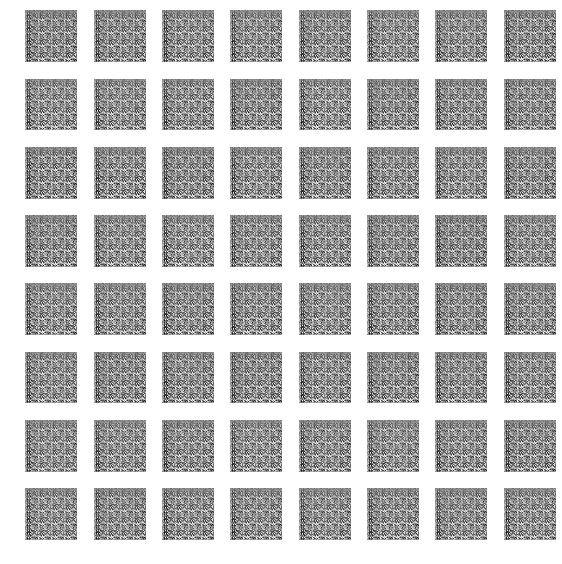

epoch:  1 time:  11.405309200286865 train_G_Loss:  1.415966 train_D_Loss:  0.88175654 train_acc:  0.64424545
epoch:  2 time:  11.314163208007812 train_G_Loss:  2.3987157 train_D_Loss:  0.9503093 train_acc:  0.6453887
epoch:  3 time:  11.33388090133667 train_G_Loss:  1.8377271 train_D_Loss:  1.186087 train_acc:  0.634718
epoch:  4 time:  11.281238317489624 train_G_Loss:  4.174054 train_D_Loss:  1.1611049 train_acc:  0.6446265
epoch:  5 time:  11.311436176300049 train_G_Loss:  2.587665 train_D_Loss:  0.7503752 train_acc:  0.6566311

cv_G_Loss: 3.021619, cv_D_loss: 1.061847, cv_acc: 0.504687

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


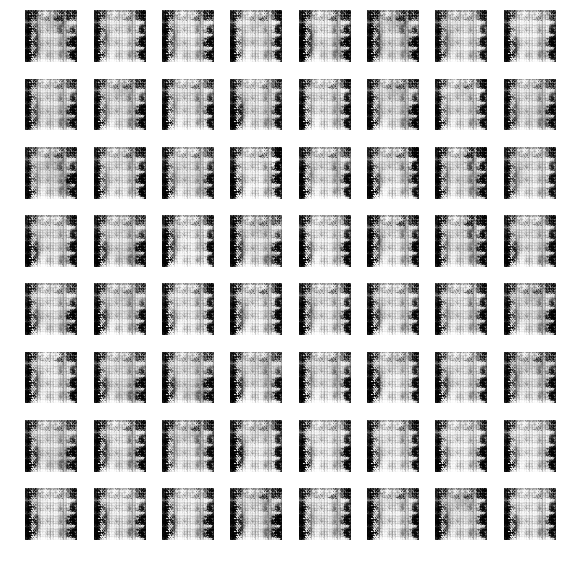

epoch:  6 time:  11.483896732330322 train_G_Loss:  3.1499994 train_D_Loss:  0.9506503 train_acc:  0.66863567
epoch:  7 time:  11.48017168045044 train_G_Loss:  1.0978364 train_D_Loss:  1.401114 train_acc:  0.6431021
epoch:  8 time:  11.466679811477661 train_G_Loss:  2.467847 train_D_Loss:  0.66720724 train_acc:  0.6899771
epoch:  9 time:  11.496090650558472 train_G_Loss:  1.516224 train_D_Loss:  1.2423134 train_acc:  0.7040777
epoch:  10 time:  11.334255695343018 train_G_Loss:  2.802658 train_D_Loss:  0.44636583 train_acc:  0.7378049

cv_G_Loss: 2.627260, cv_D_loss: 2.573910, cv_acc: 0.506250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


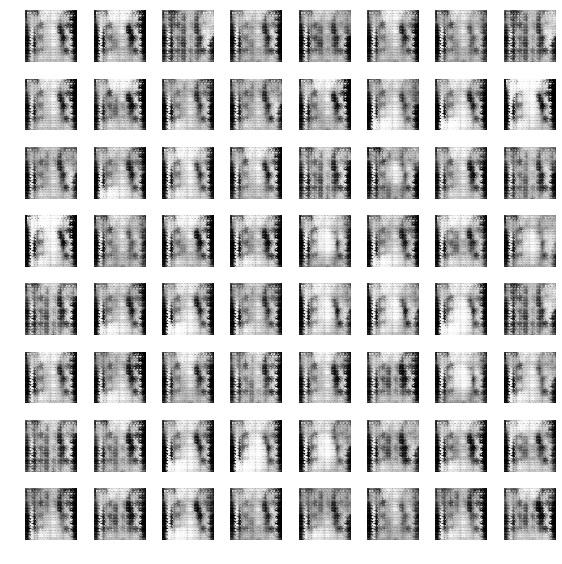

epoch:  11 time:  11.496403932571411 train_G_Loss:  1.9746128 train_D_Loss:  1.6254456 train_acc:  0.6804497
epoch:  12 time:  11.32202935218811 train_G_Loss:  2.8629365 train_D_Loss:  0.9782011 train_acc:  0.7176067
epoch:  13 time:  11.316340208053589 train_G_Loss:  3.674159 train_D_Loss:  0.6974232 train_acc:  0.72789633
epoch:  14 time:  11.326497793197632 train_G_Loss:  1.4445719 train_D_Loss:  1.2879956 train_acc:  0.722561
epoch:  15 time:  11.315691232681274 train_G_Loss:  3.3128314 train_D_Loss:  0.83069444 train_acc:  0.7275152

cv_G_Loss: 4.533496, cv_D_loss: 0.941840, cv_acc: 0.534375

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


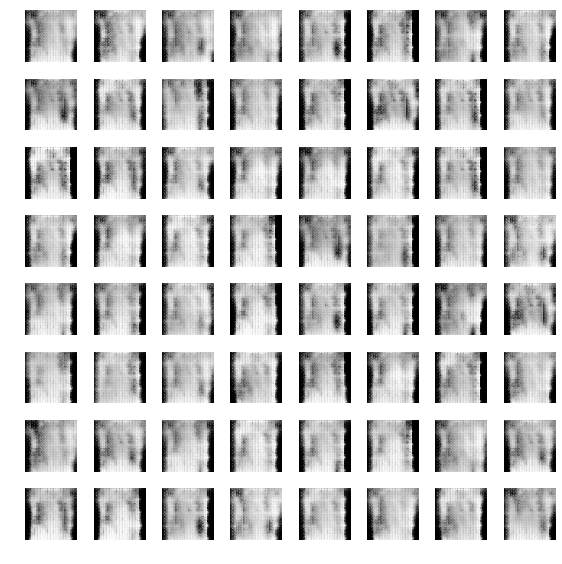

epoch:  16 time:  11.460782766342163 train_G_Loss:  2.740143 train_D_Loss:  0.8173061 train_acc:  0.7549543
epoch:  17 time:  11.341867446899414 train_G_Loss:  2.4075975 train_D_Loss:  1.1858109 train_acc:  0.7324695
epoch:  18 time:  11.356841564178467 train_G_Loss:  3.3881907 train_D_Loss:  0.7365323 train_acc:  0.73418444
epoch:  19 time:  11.362152338027954 train_G_Loss:  1.8663453 train_D_Loss:  1.5493457 train_acc:  0.7555259
epoch:  20 time:  11.318873167037964 train_G_Loss:  2.4212341 train_D_Loss:  1.0029258 train_acc:  0.74942833

cv_G_Loss: 3.272423, cv_D_loss: 1.150845, cv_acc: 0.562500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


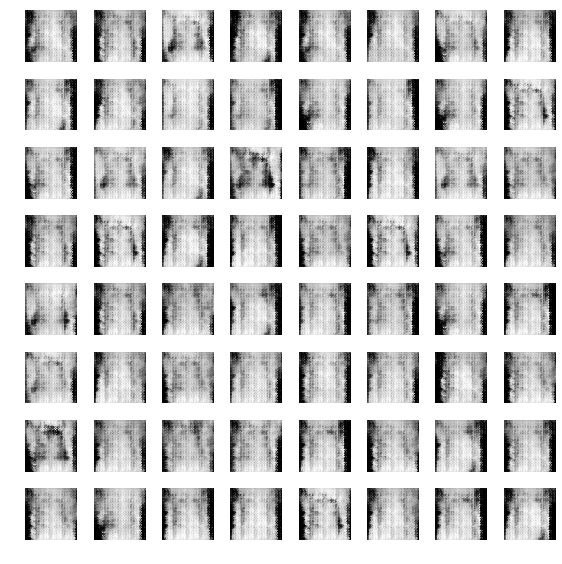

epoch:  21 time:  11.544736862182617 train_G_Loss:  2.1545944 train_D_Loss:  0.75818753 train_acc:  0.7328506
epoch:  22 time:  11.365563869476318 train_G_Loss:  3.4691324 train_D_Loss:  0.9273934 train_acc:  0.75209606
epoch:  23 time:  11.361562490463257 train_G_Loss:  3.107106 train_D_Loss:  1.083736 train_acc:  0.75571644
epoch:  24 time:  11.366302251815796 train_G_Loss:  3.814861 train_D_Loss:  1.1741053 train_acc:  0.77953506
epoch:  25 time:  11.363208293914795 train_G_Loss:  2.4553816 train_D_Loss:  1.4269987 train_acc:  0.75133383

cv_G_Loss: 1.694889, cv_D_loss: 1.366526, cv_acc: 0.564062

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


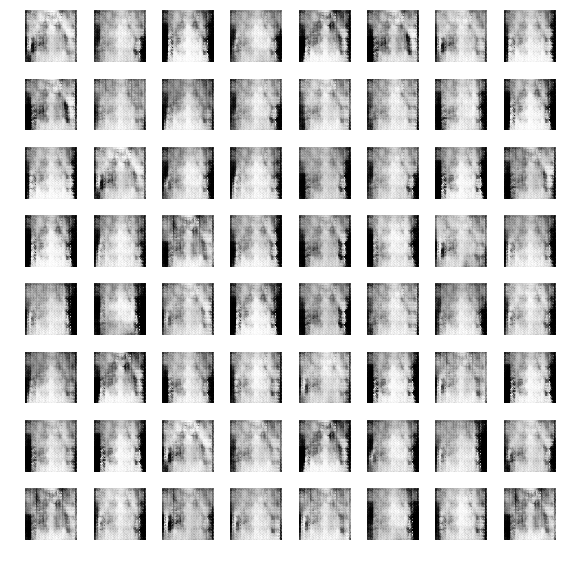

epoch:  26 time:  11.441476345062256 train_G_Loss:  1.9424167 train_D_Loss:  1.2129205 train_acc:  0.7202744
epoch:  27 time:  11.311978340148926 train_G_Loss:  2.3551354 train_D_Loss:  1.4141333 train_acc:  0.7452363
epoch:  28 time:  11.339568853378296 train_G_Loss:  2.5967073 train_D_Loss:  0.96798134 train_acc:  0.76429117
epoch:  29 time:  11.348748445510864 train_G_Loss:  2.417269 train_D_Loss:  0.98493576 train_acc:  0.755907
epoch:  30 time:  11.32085108757019 train_G_Loss:  1.3058722 train_D_Loss:  1.323278 train_acc:  0.76295733

cv_G_Loss: 1.296954, cv_D_loss: 1.197404, cv_acc: 0.531250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


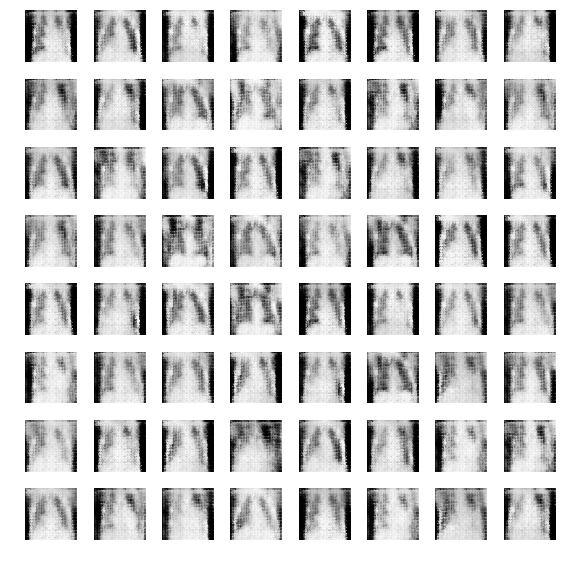

epoch:  31 time:  11.472244501113892 train_G_Loss:  2.5523524 train_D_Loss:  1.2491082 train_acc:  0.73304117
epoch:  32 time:  11.354608297348022 train_G_Loss:  1.4608516 train_D_Loss:  0.8603909 train_acc:  0.75952744
epoch:  33 time:  11.335740089416504 train_G_Loss:  3.3133647 train_D_Loss:  0.9827919 train_acc:  0.7789634
epoch:  34 time:  11.332108974456787 train_G_Loss:  2.471652 train_D_Loss:  1.0034875 train_acc:  0.7528582
epoch:  35 time:  11.335845232009888 train_G_Loss:  1.1620085 train_D_Loss:  1.2554429 train_acc:  0.7924924

cv_G_Loss: 1.889956, cv_D_loss: 0.962552, cv_acc: 0.557813

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


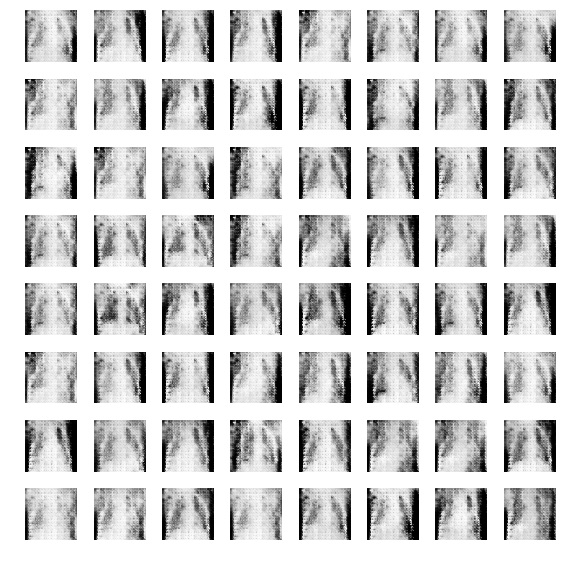

epoch:  36 time:  11.49269151687622 train_G_Loss:  2.194263 train_D_Loss:  1.0069795 train_acc:  0.7846799
epoch:  37 time:  11.330870866775513 train_G_Loss:  2.6474097 train_D_Loss:  0.7304079 train_acc:  0.7841082
epoch:  38 time:  11.338632583618164 train_G_Loss:  2.3768208 train_D_Loss:  0.51919085 train_acc:  0.7802973
epoch:  39 time:  11.321248769760132 train_G_Loss:  1.5138532 train_D_Loss:  0.8273818 train_acc:  0.7543826
epoch:  40 time:  11.333046674728394 train_G_Loss:  2.5215108 train_D_Loss:  1.2136097 train_acc:  0.7602896

cv_G_Loss: 1.230347, cv_D_loss: 1.341932, cv_acc: 0.529688

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


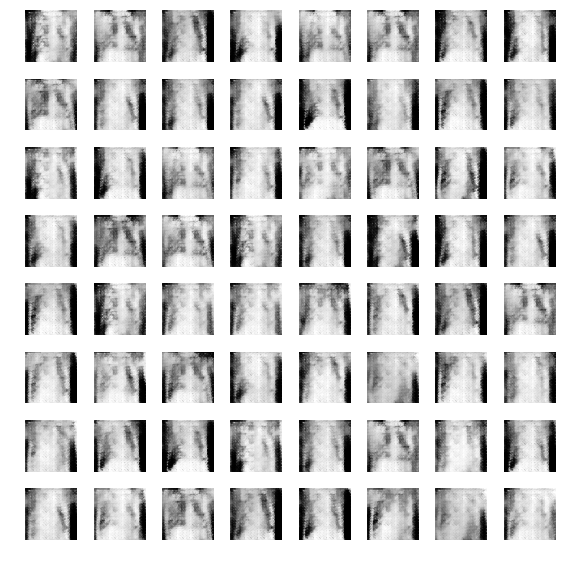

epoch:  41 time:  11.518364429473877 train_G_Loss:  3.8964083 train_D_Loss:  0.9142727 train_acc:  0.74352133
epoch:  42 time:  11.371424436569214 train_G_Loss:  2.2956104 train_D_Loss:  0.88178813 train_acc:  0.7663872
epoch:  43 time:  11.306779861450195 train_G_Loss:  2.5846443 train_D_Loss:  0.7151822 train_acc:  0.78772867
epoch:  44 time:  11.312402963638306 train_G_Loss:  2.1592505 train_D_Loss:  1.4486331 train_acc:  0.7797256
epoch:  45 time:  11.329686164855957 train_G_Loss:  2.3207233 train_D_Loss:  1.600907 train_acc:  0.77400917

cv_G_Loss: 2.982775, cv_D_loss: 1.643585, cv_acc: 0.478125

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


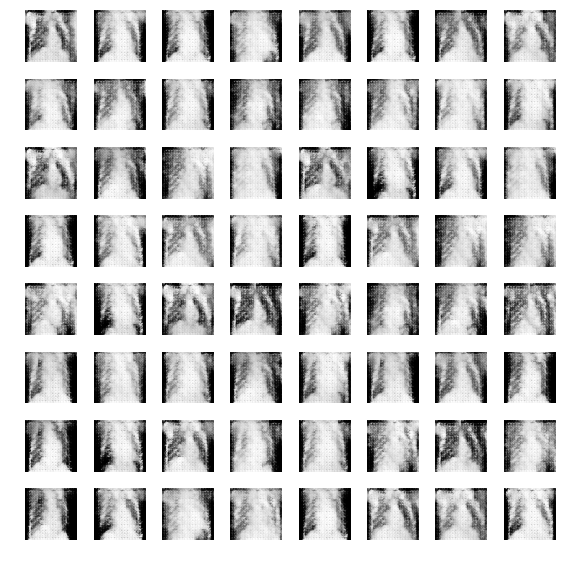

epoch:  46 time:  11.497558116912842 train_G_Loss:  2.5449765 train_D_Loss:  0.7011295 train_acc:  0.7820122
epoch:  47 time:  11.320542097091675 train_G_Loss:  1.9511614 train_D_Loss:  0.71674216 train_acc:  0.777439
epoch:  48 time:  11.307118892669678 train_G_Loss:  1.9532846 train_D_Loss:  0.95316696 train_acc:  0.7846799
epoch:  49 time:  11.314144134521484 train_G_Loss:  2.0592215 train_D_Loss:  1.3137231 train_acc:  0.79954267
epoch:  50 time:  11.31559443473816 train_G_Loss:  2.8573754 train_D_Loss:  0.38818085 train_acc:  0.7837271

cv_G_Loss: 3.191925, cv_D_loss: 0.638054, cv_acc: 0.570312

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


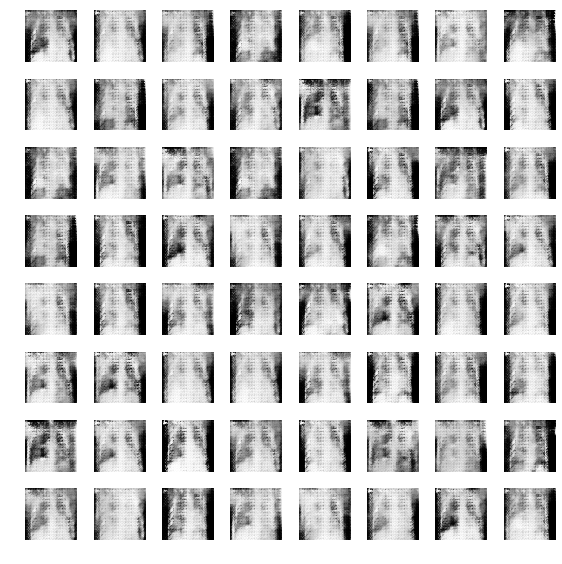

epoch:  51 time:  11.466434955596924 train_G_Loss:  2.625912 train_D_Loss:  0.7561612 train_acc:  0.7842988
epoch:  52 time:  11.330385446548462 train_G_Loss:  1.681663 train_D_Loss:  1.2678676 train_acc:  0.80678356
epoch:  53 time:  11.307823419570923 train_G_Loss:  1.903692 train_D_Loss:  1.0056732 train_acc:  0.7862043
epoch:  54 time:  11.371259927749634 train_G_Loss:  2.0561802 train_D_Loss:  0.9760671 train_acc:  0.7999238
epoch:  55 time:  11.366883277893066 train_G_Loss:  2.600943 train_D_Loss:  0.97452784 train_acc:  0.7983994

cv_G_Loss: 1.715734, cv_D_loss: 0.858399, cv_acc: 0.565625

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


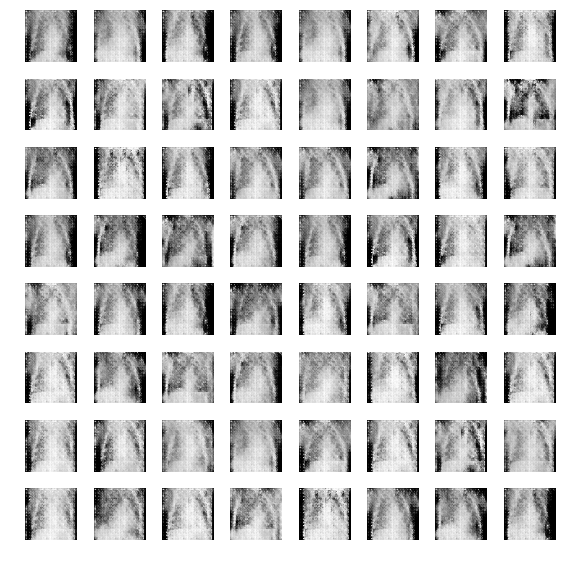

epoch:  56 time:  11.54070234298706 train_G_Loss:  2.1029952 train_D_Loss:  1.0769385 train_acc:  0.7820122
epoch:  57 time:  11.374331951141357 train_G_Loss:  1.6363608 train_D_Loss:  1.3526706 train_acc:  0.79077744
epoch:  58 time:  11.344867706298828 train_G_Loss:  1.7825979 train_D_Loss:  1.2165053 train_acc:  0.7991616
epoch:  59 time:  11.305502891540527 train_G_Loss:  1.9878433 train_D_Loss:  0.77719086 train_acc:  0.78639483
epoch:  60 time:  11.326101541519165 train_G_Loss:  1.0618346 train_D_Loss:  1.2612115 train_acc:  0.8046875

cv_G_Loss: 1.042867, cv_D_loss: 1.430757, cv_acc: 0.525000

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


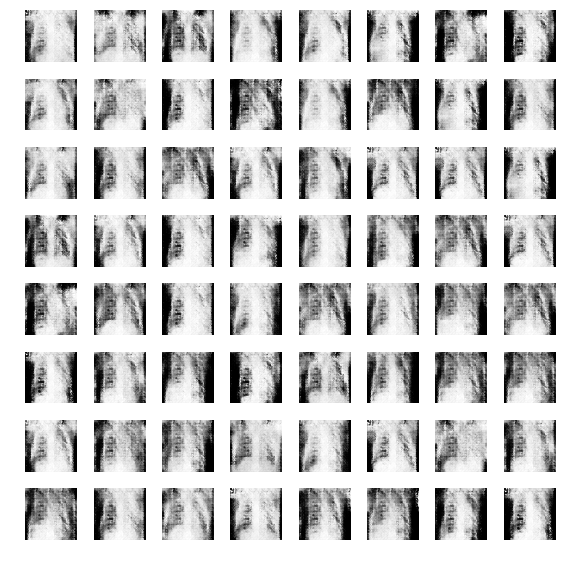

epoch:  61 time:  11.53605842590332 train_G_Loss:  2.1718202 train_D_Loss:  1.0815843 train_acc:  0.7980183
epoch:  62 time:  11.375397682189941 train_G_Loss:  1.725315 train_D_Loss:  1.1734141 train_acc:  0.79039633
epoch:  63 time:  11.329010486602783 train_G_Loss:  1.8019506 train_D_Loss:  1.2102102 train_acc:  0.80983233
epoch:  64 time:  11.32608699798584 train_G_Loss:  1.7954355 train_D_Loss:  1.1182706 train_acc:  0.8227896
epoch:  65 time:  11.314593076705933 train_G_Loss:  1.1385734 train_D_Loss:  1.5690438 train_acc:  0.8117378

cv_G_Loss: 1.048661, cv_D_loss: 1.697711, cv_acc: 0.585938

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


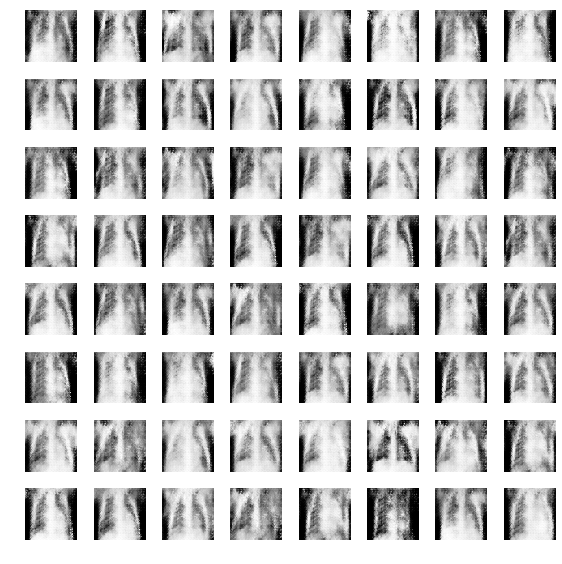

epoch:  66 time:  11.472825050354004 train_G_Loss:  2.4545345 train_D_Loss:  1.2066228 train_acc:  0.8084985
epoch:  67 time:  11.334516286849976 train_G_Loss:  1.2508957 train_D_Loss:  1.172377 train_acc:  0.78772867
epoch:  68 time:  11.331004619598389 train_G_Loss:  1.7291871 train_D_Loss:  1.1699877 train_acc:  0.79668444
epoch:  69 time:  11.35883355140686 train_G_Loss:  1.4077269 train_D_Loss:  1.1411241 train_acc:  0.8016387
epoch:  70 time:  11.34473443031311 train_G_Loss:  2.0993466 train_D_Loss:  1.5415045 train_acc:  0.79954267

cv_G_Loss: 1.578913, cv_D_loss: 1.221579, cv_acc: 0.526563

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


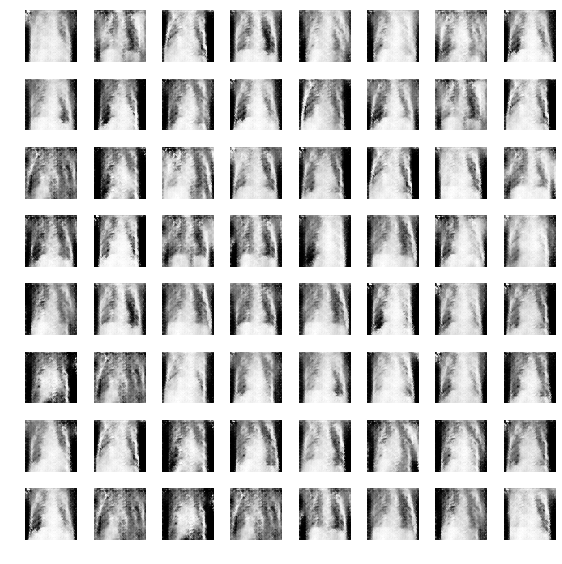

epoch:  71 time:  11.439038276672363 train_G_Loss:  1.4731374 train_D_Loss:  1.2707994 train_acc:  0.79668444
epoch:  72 time:  11.27064037322998 train_G_Loss:  2.681755 train_D_Loss:  0.95953536 train_acc:  0.78487045
epoch:  73 time:  11.29275631904602 train_G_Loss:  1.5266382 train_D_Loss:  0.9999624 train_acc:  0.79420733
epoch:  74 time:  11.293884992599487 train_G_Loss:  1.5448899 train_D_Loss:  0.8838344 train_acc:  0.80792683
epoch:  75 time:  11.281514883041382 train_G_Loss:  1.7950768 train_D_Loss:  1.5205973 train_acc:  0.8153582

cv_G_Loss: 2.094621, cv_D_loss: 0.971728, cv_acc: 0.576563

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


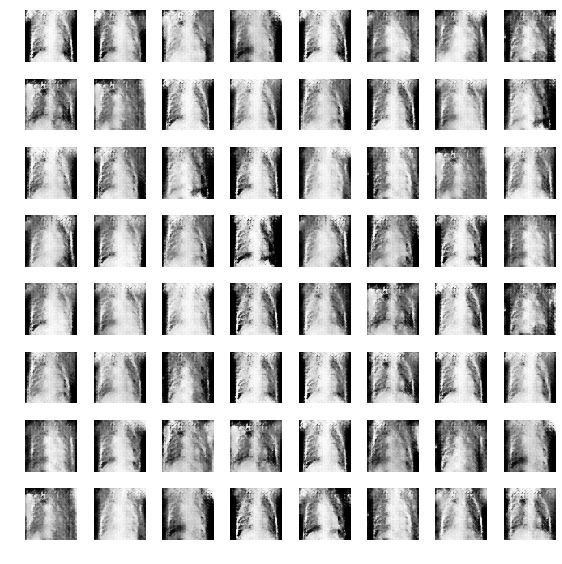

epoch:  76 time:  11.438791275024414 train_G_Loss:  1.860932 train_D_Loss:  1.3311514 train_acc:  0.81116617
epoch:  77 time:  11.307666301727295 train_G_Loss:  2.4646678 train_D_Loss:  0.64976907 train_acc:  0.81383383
epoch:  78 time:  11.294601678848267 train_G_Loss:  2.3050814 train_D_Loss:  1.0410969 train_acc:  0.8132622
epoch:  79 time:  11.341570854187012 train_G_Loss:  2.4568558 train_D_Loss:  0.69782436 train_acc:  0.8081174
epoch:  80 time:  11.353261232376099 train_G_Loss:  1.9288328 train_D_Loss:  0.81402075 train_acc:  0.81707317

cv_G_Loss: 2.361900, cv_D_loss: 1.331357, cv_acc: 0.562500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


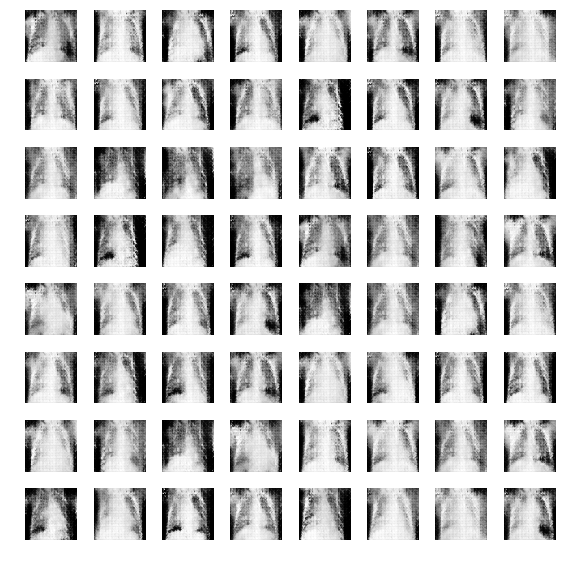

epoch:  81 time:  11.485620975494385 train_G_Loss:  2.0635746 train_D_Loss:  0.879881 train_acc:  0.82088417
epoch:  82 time:  11.28550910949707 train_G_Loss:  2.0861075 train_D_Loss:  0.9613165 train_acc:  0.8149771
epoch:  83 time:  11.348720073699951 train_G_Loss:  2.054515 train_D_Loss:  1.1466733 train_acc:  0.80792683
epoch:  84 time:  11.335370779037476 train_G_Loss:  1.9338634 train_D_Loss:  0.9824026 train_acc:  0.82088417
epoch:  85 time:  11.32465410232544 train_G_Loss:  2.1119144 train_D_Loss:  0.86788976 train_acc:  0.8292683

cv_G_Loss: 1.471820, cv_D_loss: 1.401958, cv_acc: 0.589063

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


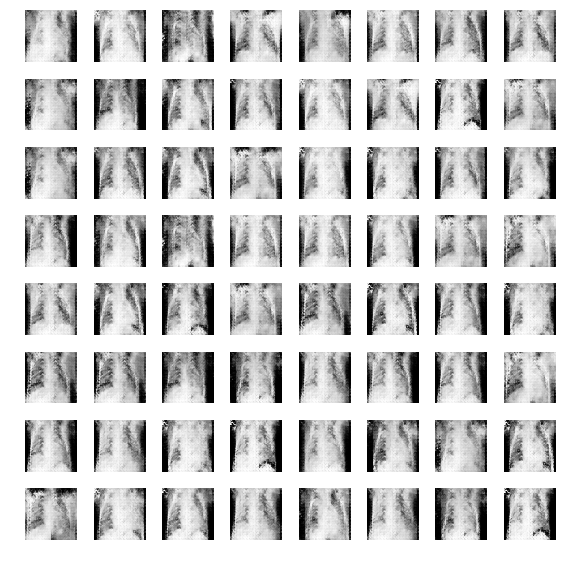

epoch:  86 time:  11.441068410873413 train_G_Loss:  2.323938 train_D_Loss:  0.5701004 train_acc:  0.8233613
epoch:  87 time:  11.325254440307617 train_G_Loss:  1.9737765 train_D_Loss:  1.0619026 train_acc:  0.81897867
epoch:  88 time:  11.371554374694824 train_G_Loss:  2.5660892 train_D_Loss:  0.493932 train_acc:  0.82679117
epoch:  89 time:  11.361522197723389 train_G_Loss:  1.8646302 train_D_Loss:  1.0725522 train_acc:  0.8258384
epoch:  90 time:  11.398074865341187 train_G_Loss:  2.0039737 train_D_Loss:  0.6313703 train_acc:  0.8191692

cv_G_Loss: 1.747476, cv_D_loss: 1.166127, cv_acc: 0.532812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


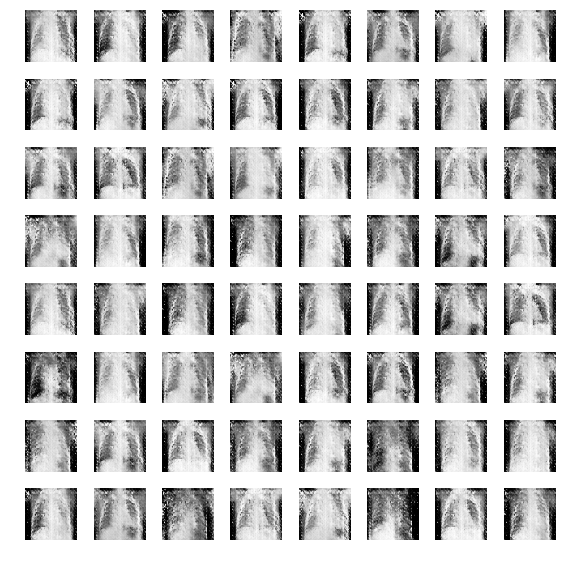

epoch:  91 time:  11.5507230758667 train_G_Loss:  1.9298973 train_D_Loss:  0.8361932 train_acc:  0.8172637
epoch:  92 time:  11.289798259735107 train_G_Loss:  1.6211141 train_D_Loss:  0.71059364 train_acc:  0.83269817
epoch:  93 time:  11.342328786849976 train_G_Loss:  1.6396856 train_D_Loss:  1.1588751 train_acc:  0.8172637
epoch:  94 time:  11.328329086303711 train_G_Loss:  2.2164893 train_D_Loss:  1.037601 train_acc:  0.82240856
epoch:  95 time:  11.294585704803467 train_G_Loss:  1.8789216 train_D_Loss:  0.89545184 train_acc:  0.82983994

cv_G_Loss: 1.617056, cv_D_loss: 1.894911, cv_acc: 0.600000

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


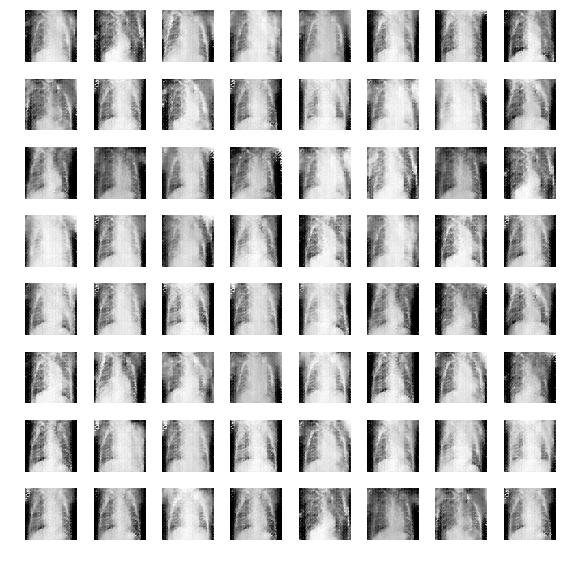

epoch:  96 time:  11.448040962219238 train_G_Loss:  2.2161443 train_D_Loss:  1.9622438 train_acc:  0.83136433
epoch:  97 time:  11.314635276794434 train_G_Loss:  2.0916114 train_D_Loss:  1.6678059 train_acc:  0.822218
epoch:  98 time:  11.465563297271729 train_G_Loss:  2.3869019 train_D_Loss:  1.3010507 train_acc:  0.8328887
epoch:  99 time:  11.32102656364441 train_G_Loss:  2.3035102 train_D_Loss:  0.5310915 train_acc:  0.8094512
epoch:  100 time:  11.316456317901611 train_G_Loss:  1.1443259 train_D_Loss:  1.7249749 train_acc:  0.8062119

cv_G_Loss: 1.069669, cv_D_loss: 1.741746, cv_acc: 0.542188

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


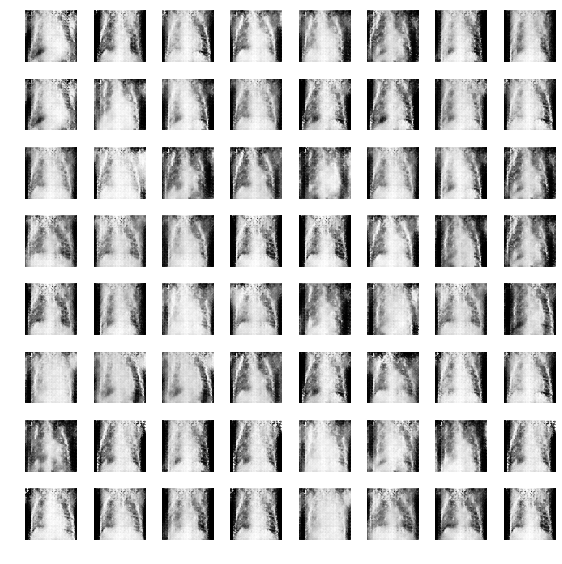

epoch:  101 time:  11.476873636245728 train_G_Loss:  2.313135 train_D_Loss:  1.0210605 train_acc:  0.83384144
epoch:  102 time:  11.32749605178833 train_G_Loss:  1.7155552 train_D_Loss:  1.1647713 train_acc:  0.82831556
epoch:  103 time:  11.34928011894226 train_G_Loss:  1.4703032 train_D_Loss:  0.7609987 train_acc:  0.82983994
epoch:  104 time:  11.34993863105774 train_G_Loss:  1.2237121 train_D_Loss:  1.1844816 train_acc:  0.8330793
epoch:  105 time:  11.337836980819702 train_G_Loss:  1.7994047 train_D_Loss:  0.59005445 train_acc:  0.82050306

cv_G_Loss: 1.400831, cv_D_loss: 0.992653, cv_acc: 0.570312

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


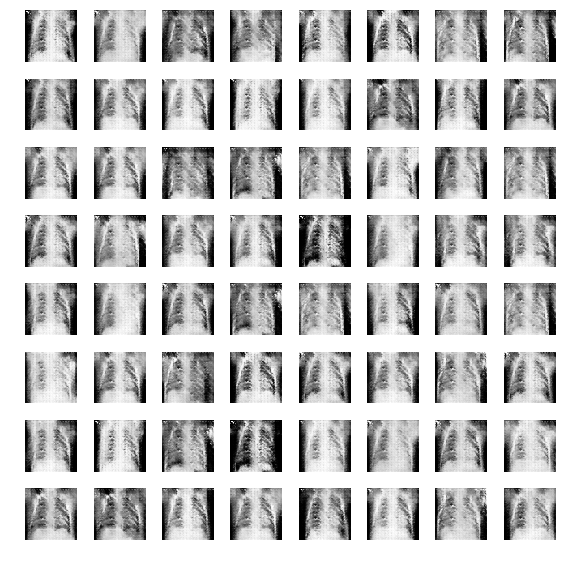

epoch:  106 time:  11.506852865219116 train_G_Loss:  1.0092854 train_D_Loss:  0.93703806 train_acc:  0.8382241
epoch:  107 time:  11.352984189987183 train_G_Loss:  2.3560872 train_D_Loss:  0.84356034 train_acc:  0.8407012
epoch:  108 time:  11.392898321151733 train_G_Loss:  1.8504227 train_D_Loss:  0.81441796 train_acc:  0.837843
epoch:  109 time:  11.326309204101562 train_G_Loss:  1.6169543 train_D_Loss:  1.3450234 train_acc:  0.83536583
epoch:  110 time:  11.333438158035278 train_G_Loss:  2.205455 train_D_Loss:  1.0393431 train_acc:  0.8393674

cv_G_Loss: 1.136167, cv_D_loss: 1.789984, cv_acc: 0.523438

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


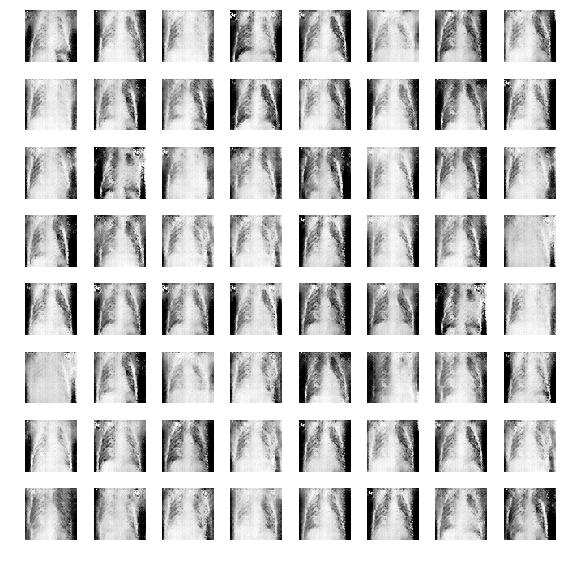

epoch:  111 time:  11.461332559585571 train_G_Loss:  1.3557932 train_D_Loss:  1.2677975 train_acc:  0.83536583
epoch:  112 time:  11.324886560440063 train_G_Loss:  2.0982068 train_D_Loss:  0.9070594 train_acc:  0.8233613
epoch:  113 time:  11.312962293624878 train_G_Loss:  1.9315665 train_D_Loss:  0.7818496 train_acc:  0.8433689
epoch:  114 time:  11.324296474456787 train_G_Loss:  2.550615 train_D_Loss:  1.2215909 train_acc:  0.82050306
epoch:  115 time:  11.323631286621094 train_G_Loss:  2.1941664 train_D_Loss:  0.9122672 train_acc:  0.84108233

cv_G_Loss: 1.378080, cv_D_loss: 1.439882, cv_acc: 0.545313

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


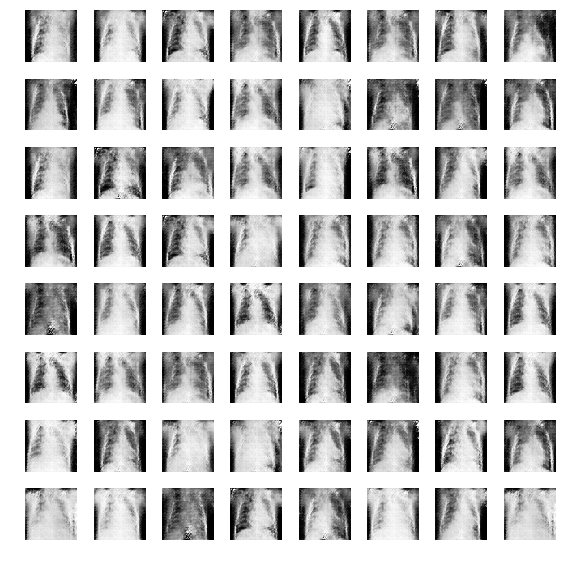

epoch:  116 time:  11.498172760009766 train_G_Loss:  1.6628668 train_D_Loss:  1.795957 train_acc:  0.8191692
epoch:  117 time:  11.305198907852173 train_G_Loss:  2.4932485 train_D_Loss:  0.5620384 train_acc:  0.82393295
epoch:  118 time:  11.32023000717163 train_G_Loss:  2.3259683 train_D_Loss:  1.0134307 train_acc:  0.8462271
epoch:  119 time:  11.365726470947266 train_G_Loss:  3.4121408 train_D_Loss:  1.1942868 train_acc:  0.8467988
epoch:  120 time:  11.36242938041687 train_G_Loss:  1.7089779 train_D_Loss:  1.0609705 train_acc:  0.81974083

cv_G_Loss: 2.638556, cv_D_loss: 1.088214, cv_acc: 0.578125

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


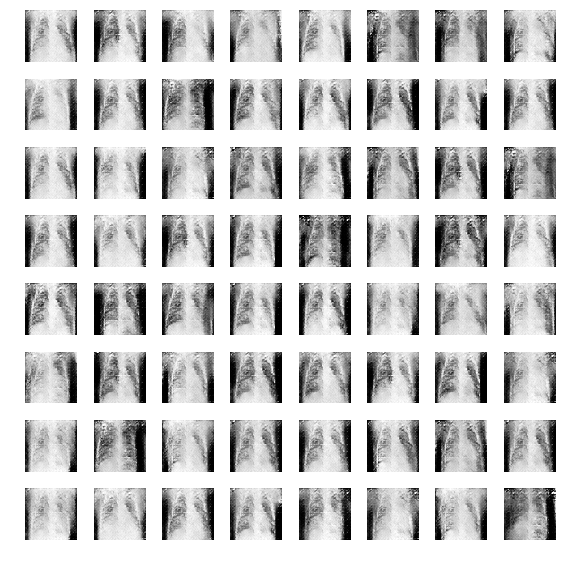

epoch:  121 time:  11.527650356292725 train_G_Loss:  2.4561143 train_D_Loss:  0.7641684 train_acc:  0.81707317
epoch:  122 time:  11.376418113708496 train_G_Loss:  1.62274 train_D_Loss:  1.3676469 train_acc:  0.8214558
epoch:  123 time:  11.388746976852417 train_G_Loss:  1.7571349 train_D_Loss:  1.0228229 train_acc:  0.8218369
epoch:  124 time:  11.381306171417236 train_G_Loss:  1.6878153 train_D_Loss:  1.3676062 train_acc:  0.8134527
epoch:  125 time:  11.346657991409302 train_G_Loss:  1.9985634 train_D_Loss:  1.6418483 train_acc:  0.83269817

cv_G_Loss: 1.508386, cv_D_loss: 1.836834, cv_acc: 0.601562

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


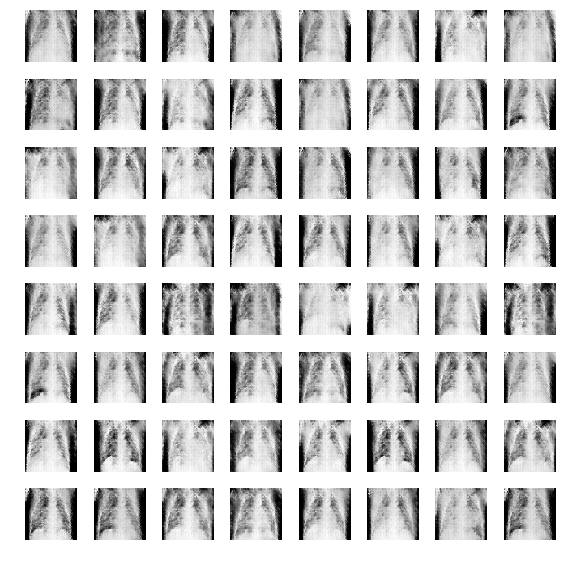

epoch:  126 time:  11.474857807159424 train_G_Loss:  2.3539343 train_D_Loss:  0.5348693 train_acc:  0.83650917
epoch:  127 time:  11.383078813552856 train_G_Loss:  1.4540374 train_D_Loss:  1.6904969 train_acc:  0.8292683
epoch:  128 time:  11.372027397155762 train_G_Loss:  2.6319582 train_D_Loss:  1.4436646 train_acc:  0.8258384
epoch:  129 time:  11.32231616973877 train_G_Loss:  2.7556846 train_D_Loss:  0.829628 train_acc:  0.828125
epoch:  130 time:  11.335538864135742 train_G_Loss:  2.388205 train_D_Loss:  1.3126128 train_acc:  0.83955795

cv_G_Loss: 2.515960, cv_D_loss: 1.928694, cv_acc: 0.585938

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


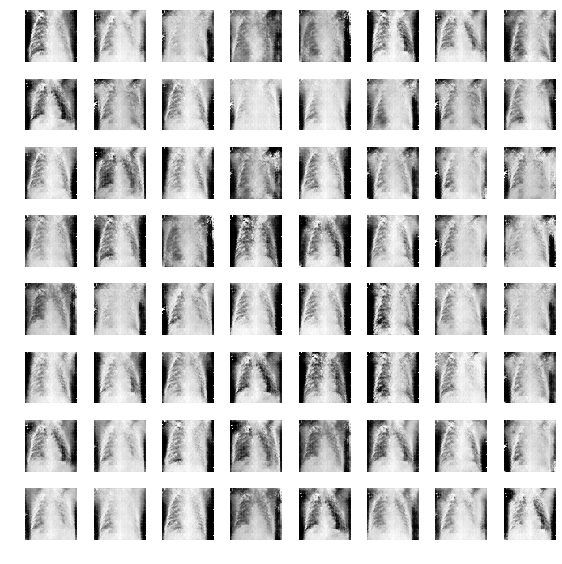

epoch:  131 time:  11.443440914154053 train_G_Loss:  2.2404687 train_D_Loss:  1.3795333 train_acc:  0.8384146
epoch:  132 time:  11.347995281219482 train_G_Loss:  2.1550307 train_D_Loss:  0.88932675 train_acc:  0.8256479
epoch:  133 time:  11.301561832427979 train_G_Loss:  2.661655 train_D_Loss:  0.8731016 train_acc:  0.822218
epoch:  134 time:  11.293495416641235 train_G_Loss:  2.2559638 train_D_Loss:  0.69254565 train_acc:  0.83384144
epoch:  135 time:  11.29358720779419 train_G_Loss:  2.6177816 train_D_Loss:  0.7037389 train_acc:  0.8347942

cv_G_Loss: 3.017668, cv_D_loss: 0.939691, cv_acc: 0.548437

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


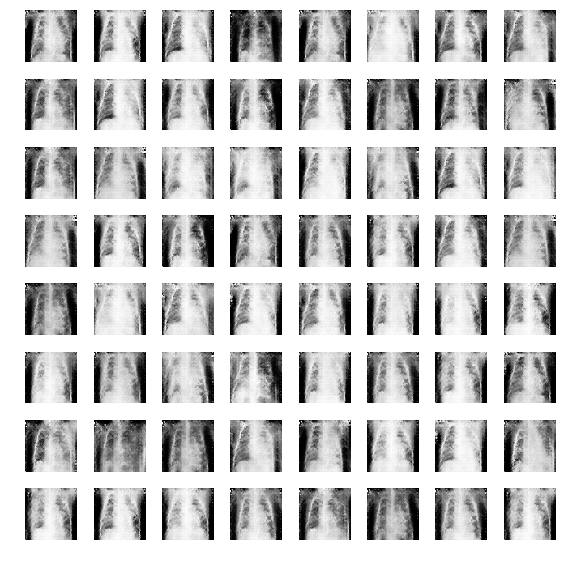

epoch:  136 time:  11.449002504348755 train_G_Loss:  1.2015059 train_D_Loss:  1.2499975 train_acc:  0.8325076
epoch:  137 time:  11.311743021011353 train_G_Loss:  1.1565925 train_D_Loss:  1.8729566 train_acc:  0.828125
epoch:  138 time:  11.302334547042847 train_G_Loss:  1.8786882 train_D_Loss:  0.9558417 train_acc:  0.83384144
epoch:  139 time:  11.35581636428833 train_G_Loss:  2.5119994 train_D_Loss:  1.4882461 train_acc:  0.8540396
epoch:  140 time:  11.327998161315918 train_G_Loss:  1.7530979 train_D_Loss:  0.8641505 train_acc:  0.82831556

cv_G_Loss: 0.977102, cv_D_loss: 2.227892, cv_acc: 0.553125

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


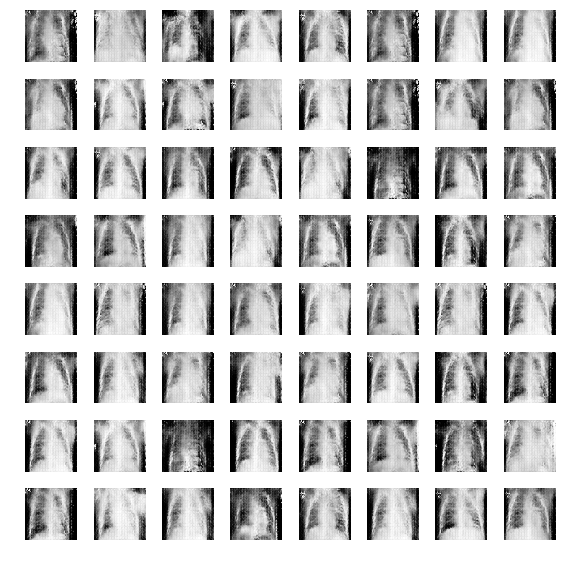

epoch:  141 time:  11.40863585472107 train_G_Loss:  2.1220403 train_D_Loss:  0.8769805 train_acc:  0.84317833
epoch:  142 time:  11.348503351211548 train_G_Loss:  1.8944396 train_D_Loss:  0.9488772 train_acc:  0.83422256
epoch:  143 time:  11.3045973777771 train_G_Loss:  1.8661964 train_D_Loss:  1.0287905 train_acc:  0.83174545
epoch:  144 time:  11.355144739151001 train_G_Loss:  1.678236 train_D_Loss:  1.0899253 train_acc:  0.8549924
epoch:  145 time:  11.335345983505249 train_G_Loss:  2.0880272 train_D_Loss:  0.92589027 train_acc:  0.8334604

cv_G_Loss: 1.543207, cv_D_loss: 1.634754, cv_acc: 0.457812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


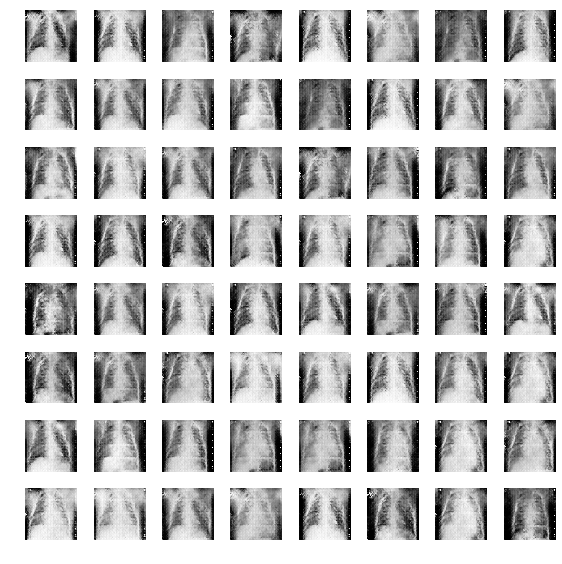

epoch:  146 time:  11.447001457214355 train_G_Loss:  1.3800645 train_D_Loss:  1.2663596 train_acc:  0.8347942
epoch:  147 time:  11.341650485992432 train_G_Loss:  1.4656872 train_D_Loss:  1.2565187 train_acc:  0.85918444
epoch:  148 time:  11.294284105300903 train_G_Loss:  1.6575798 train_D_Loss:  2.3295531 train_acc:  0.8393674
epoch:  149 time:  11.29884648323059 train_G_Loss:  2.4690995 train_D_Loss:  1.0493135 train_acc:  0.83917683
epoch:  150 time:  11.293755531311035 train_G_Loss:  1.399757 train_D_Loss:  1.2458689 train_acc:  0.84317833

cv_G_Loss: 1.413792, cv_D_loss: 2.421122, cv_acc: 0.582812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


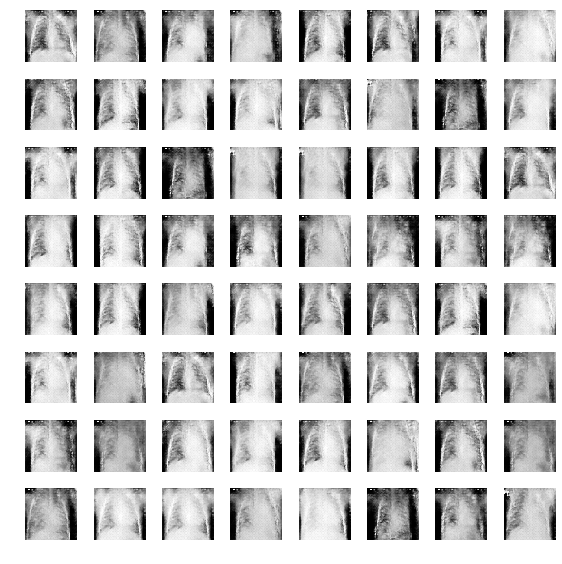

epoch:  151 time:  11.53635835647583 train_G_Loss:  1.6263475 train_D_Loss:  1.4002128 train_acc:  0.8408918
epoch:  152 time:  11.364622354507446 train_G_Loss:  1.4889159 train_D_Loss:  1.0943644 train_acc:  0.82641006
epoch:  153 time:  11.35942268371582 train_G_Loss:  1.8046206 train_D_Loss:  1.559 train_acc:  0.83460367
epoch:  154 time:  11.356070280075073 train_G_Loss:  1.4711927 train_D_Loss:  1.3440478 train_acc:  0.83384144
epoch:  155 time:  11.30285358428955 train_G_Loss:  1.4377363 train_D_Loss:  1.1423407 train_acc:  0.8467988

cv_G_Loss: 1.341124, cv_D_loss: 1.934853, cv_acc: 0.462500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


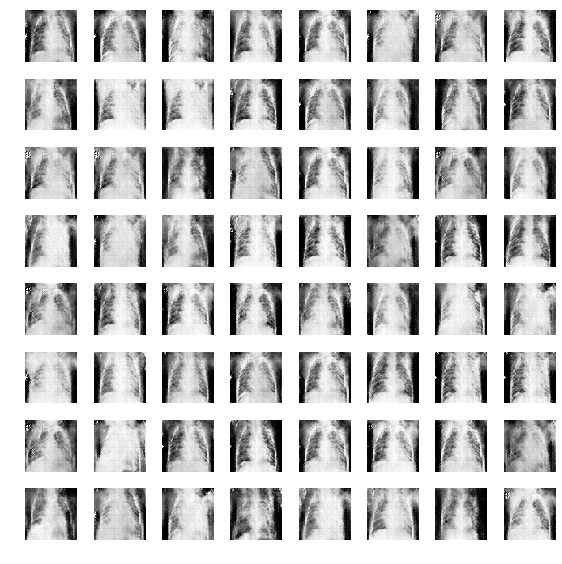

epoch:  156 time:  11.432675838470459 train_G_Loss:  1.3165727 train_D_Loss:  0.8399339 train_acc:  0.8456555
epoch:  157 time:  11.223074674606323 train_G_Loss:  1.3992156 train_D_Loss:  0.72636545 train_acc:  0.8315549
epoch:  158 time:  11.224768877029419 train_G_Loss:  1.4689487 train_D_Loss:  1.9565117 train_acc:  0.8549924
epoch:  159 time:  11.259397745132446 train_G_Loss:  1.6710459 train_D_Loss:  1.0345446 train_acc:  0.85289633
epoch:  160 time:  11.258655309677124 train_G_Loss:  2.3620267 train_D_Loss:  1.1499114 train_acc:  0.8347942

cv_G_Loss: 1.987050, cv_D_loss: 1.239374, cv_acc: 0.560938

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


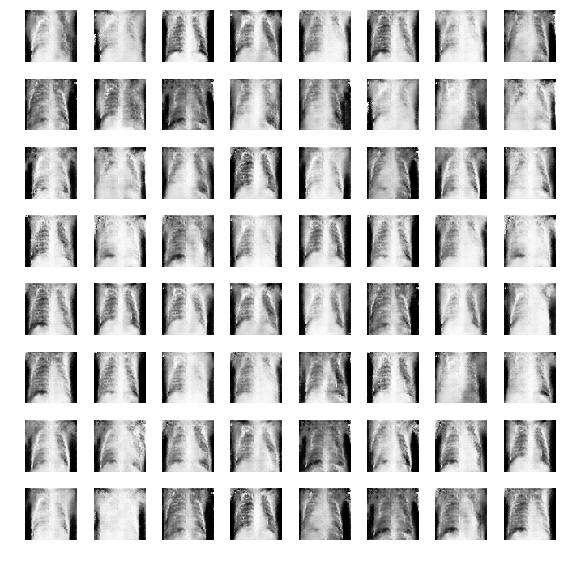

epoch:  161 time:  11.424207210540771 train_G_Loss:  2.15663 train_D_Loss:  1.1564996 train_acc:  0.8344131
epoch:  162 time:  11.395461082458496 train_G_Loss:  1.7733984 train_D_Loss:  0.8605066 train_acc:  0.8426067
epoch:  163 time:  11.338948726654053 train_G_Loss:  1.1595681 train_D_Loss:  1.5832291 train_acc:  0.8393674
epoch:  164 time:  11.349922895431519 train_G_Loss:  1.5239959 train_D_Loss:  1.206206 train_acc:  0.8519436
epoch:  165 time:  11.402375936508179 train_G_Loss:  1.6801379 train_D_Loss:  0.86043227 train_acc:  0.84203506

cv_G_Loss: 2.484390, cv_D_loss: 1.423983, cv_acc: 0.548437

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


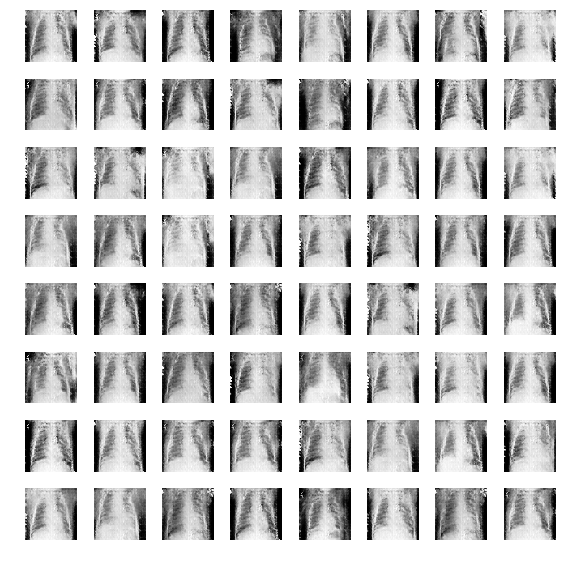

epoch:  166 time:  11.463916540145874 train_G_Loss:  1.972623 train_D_Loss:  1.5935972 train_acc:  0.8519436
epoch:  167 time:  11.30933952331543 train_G_Loss:  1.9575499 train_D_Loss:  1.2026039 train_acc:  0.83765244
epoch:  168 time:  11.316543817520142 train_G_Loss:  1.6200719 train_D_Loss:  0.9698068 train_acc:  0.8616616
epoch:  169 time:  11.315357446670532 train_G_Loss:  1.887955 train_D_Loss:  1.368853 train_acc:  0.8504192
epoch:  170 time:  11.325554847717285 train_G_Loss:  2.4030616 train_D_Loss:  1.133752 train_acc:  0.8315549

cv_G_Loss: 1.803320, cv_D_loss: 1.294316, cv_acc: 0.592188

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


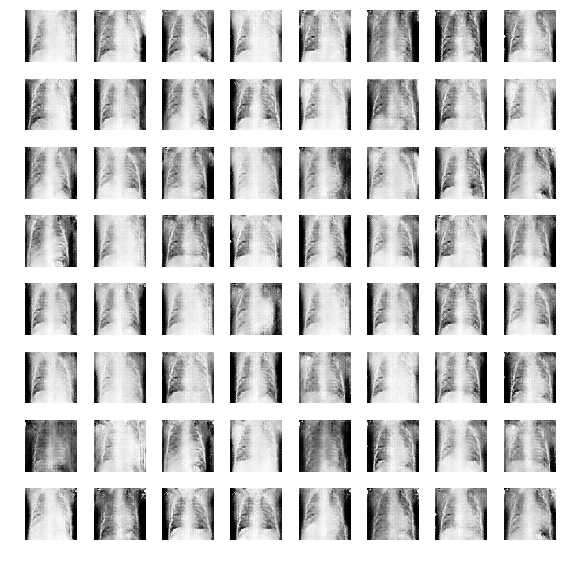

epoch:  171 time:  11.535731315612793 train_G_Loss:  2.4705293 train_D_Loss:  1.1460723 train_acc:  0.84546494
epoch:  172 time:  11.461938381195068 train_G_Loss:  1.5985206 train_D_Loss:  0.7473129 train_acc:  0.8462271
epoch:  173 time:  11.360371112823486 train_G_Loss:  1.9777653 train_D_Loss:  0.9923071 train_acc:  0.83269817
epoch:  174 time:  11.377185106277466 train_G_Loss:  2.739239 train_D_Loss:  1.6198947 train_acc:  0.8563262
epoch:  175 time:  11.346017599105835 train_G_Loss:  2.083996 train_D_Loss:  1.3711095 train_acc:  0.8527058

cv_G_Loss: 1.587056, cv_D_loss: 1.330773, cv_acc: 0.590625

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


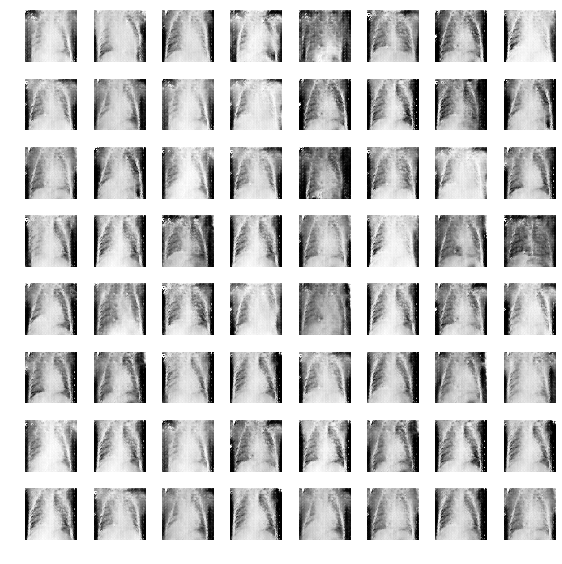

epoch:  176 time:  11.557322263717651 train_G_Loss:  1.9998348 train_D_Loss:  1.262212 train_acc:  0.84641767
epoch:  177 time:  11.36094069480896 train_G_Loss:  2.1961596 train_D_Loss:  0.58753824 train_acc:  0.84832317
epoch:  178 time:  11.330380916595459 train_G_Loss:  1.797592 train_D_Loss:  0.52107036 train_acc:  0.8344131
epoch:  179 time:  11.33375883102417 train_G_Loss:  2.1521971 train_D_Loss:  0.8034426 train_acc:  0.84317833
epoch:  180 time:  11.355884075164795 train_G_Loss:  1.7005693 train_D_Loss:  0.92057127 train_acc:  0.84051067

cv_G_Loss: 1.533795, cv_D_loss: 1.286822, cv_acc: 0.575000

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


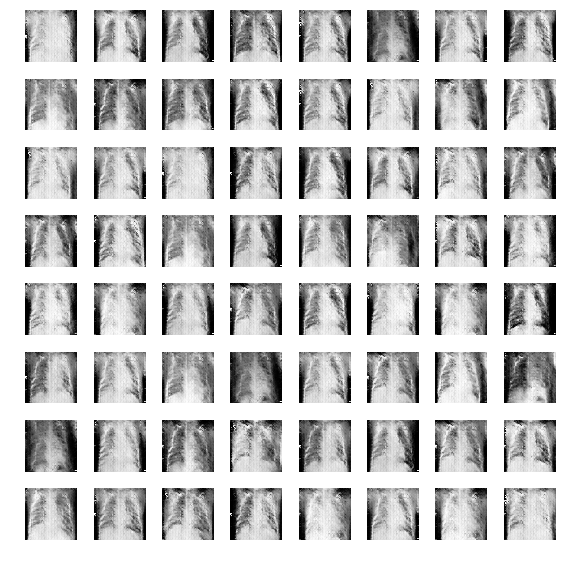

epoch:  181 time:  11.64522409439087 train_G_Loss:  1.8570323 train_D_Loss:  1.2268667 train_acc:  0.8589939
epoch:  182 time:  11.509089708328247 train_G_Loss:  2.354755 train_D_Loss:  0.43957952 train_acc:  0.8563262
epoch:  183 time:  11.380713939666748 train_G_Loss:  1.8355225 train_D_Loss:  0.9811672 train_acc:  0.8452744
epoch:  184 time:  11.361021280288696 train_G_Loss:  2.089532 train_D_Loss:  1.2869836 train_acc:  0.859375
epoch:  185 time:  11.350215673446655 train_G_Loss:  2.2295468 train_D_Loss:  1.3620253 train_acc:  0.85175306

cv_G_Loss: 1.329956, cv_D_loss: 2.035656, cv_acc: 0.581250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


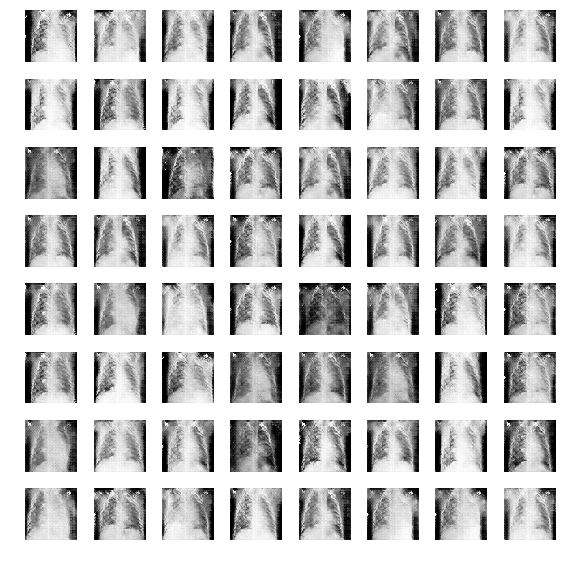

epoch:  186 time:  11.520386695861816 train_G_Loss:  1.8215352 train_D_Loss:  0.71966213 train_acc:  0.8485137
epoch:  187 time:  11.353057384490967 train_G_Loss:  1.6281209 train_D_Loss:  0.9703533 train_acc:  0.8490854
epoch:  188 time:  11.338310480117798 train_G_Loss:  1.5643824 train_D_Loss:  1.2087274 train_acc:  0.8426067
epoch:  189 time:  11.377648830413818 train_G_Loss:  2.374931 train_D_Loss:  1.5659177 train_acc:  0.8574695
epoch:  190 time:  11.359110593795776 train_G_Loss:  1.5719017 train_D_Loss:  0.8494099 train_acc:  0.8649009

cv_G_Loss: 1.198193, cv_D_loss: 1.758470, cv_acc: 0.606250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


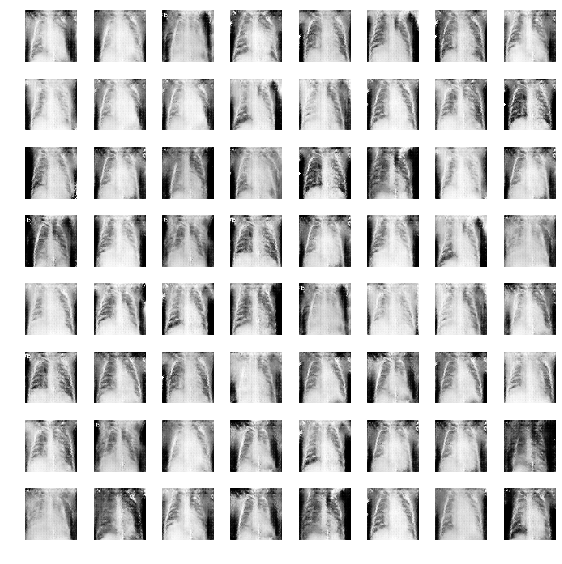

epoch:  191 time:  11.523757696151733 train_G_Loss:  1.9995756 train_D_Loss:  1.0235875 train_acc:  0.8540396
epoch:  192 time:  11.402858972549438 train_G_Loss:  1.8247203 train_D_Loss:  0.8211018 train_acc:  0.8530869
epoch:  193 time:  11.437536239624023 train_G_Loss:  2.0996597 train_D_Loss:  1.0199972 train_acc:  0.84889483
epoch:  194 time:  11.385632514953613 train_G_Loss:  2.2151887 train_D_Loss:  0.8386207 train_acc:  0.8586128
epoch:  195 time:  11.352893352508545 train_G_Loss:  1.7702357 train_D_Loss:  0.8760733 train_acc:  0.8500381

cv_G_Loss: 1.117597, cv_D_loss: 1.633825, cv_acc: 0.593750

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


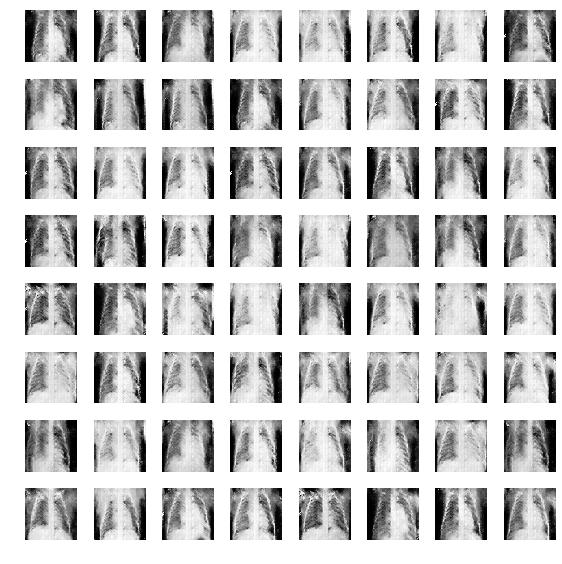

epoch:  196 time:  11.521587133407593 train_G_Loss:  1.3795214 train_D_Loss:  0.8872943 train_acc:  0.8447027
epoch:  197 time:  11.364672660827637 train_G_Loss:  1.9287773 train_D_Loss:  0.73731136 train_acc:  0.8546113
epoch:  198 time:  11.36623477935791 train_G_Loss:  1.8821547 train_D_Loss:  1.0821562 train_acc:  0.8408918
epoch:  199 time:  11.353114366531372 train_G_Loss:  1.4441969 train_D_Loss:  1.7041789 train_acc:  0.85994667
epoch:  200 time:  11.352357387542725 train_G_Loss:  1.5191767 train_D_Loss:  1.1067944 train_acc:  0.85918444

cv_G_Loss: 0.793563, cv_D_loss: 1.733480, cv_acc: 0.532812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


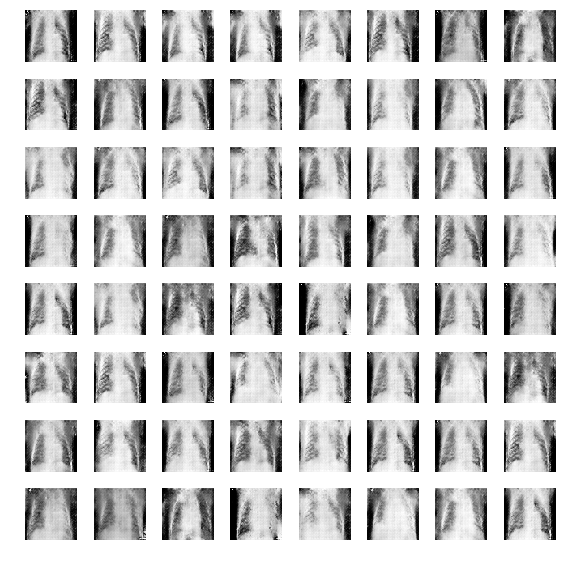

epoch:  201 time:  11.529985904693604 train_G_Loss:  1.5767856 train_D_Loss:  0.903195 train_acc:  0.8349848
epoch:  202 time:  11.35266375541687 train_G_Loss:  2.0103338 train_D_Loss:  1.4408227 train_acc:  0.8538491
epoch:  203 time:  11.351285457611084 train_G_Loss:  2.4721262 train_D_Loss:  0.6083983 train_acc:  0.8351753
epoch:  204 time:  11.35628628730774 train_G_Loss:  2.1956666 train_D_Loss:  0.6101701 train_acc:  0.85365856
epoch:  205 time:  11.355996370315552 train_G_Loss:  1.4739908 train_D_Loss:  1.0014712 train_acc:  0.8538491

cv_G_Loss: 0.983122, cv_D_loss: 1.899313, cv_acc: 0.582812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


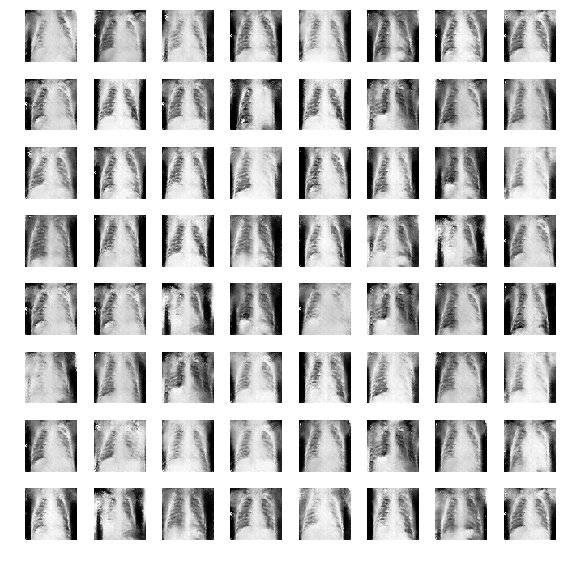

epoch:  206 time:  11.531774282455444 train_G_Loss:  1.3638265 train_D_Loss:  0.9118447 train_acc:  0.8649009
epoch:  207 time:  11.3696608543396 train_G_Loss:  1.7862889 train_D_Loss:  1.1291618 train_acc:  0.86585367
epoch:  208 time:  11.339123725891113 train_G_Loss:  1.9291797 train_D_Loss:  0.6622366 train_acc:  0.865282
epoch:  209 time:  11.346788167953491 train_G_Loss:  1.8471348 train_D_Loss:  0.6418261 train_acc:  0.84584606
epoch:  210 time:  11.365492820739746 train_G_Loss:  1.9957124 train_D_Loss:  1.3236262 train_acc:  0.86928356

cv_G_Loss: 2.058804, cv_D_loss: 2.087592, cv_acc: 0.590625

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


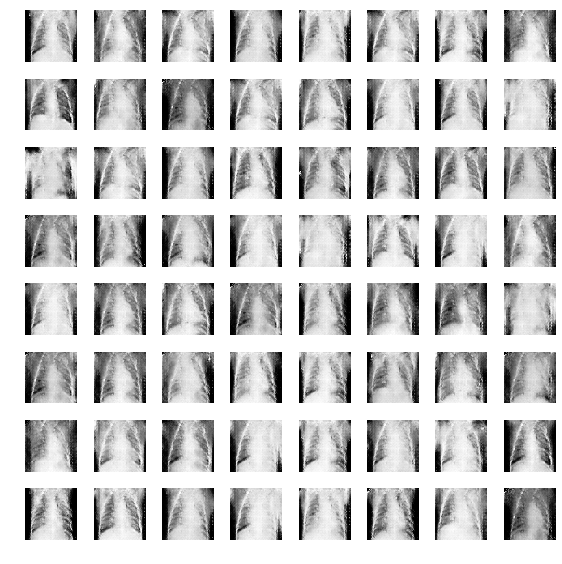

epoch:  211 time:  11.556960582733154 train_G_Loss:  1.8916485 train_D_Loss:  0.53741866 train_acc:  0.8601372
epoch:  212 time:  11.356698989868164 train_G_Loss:  1.6475631 train_D_Loss:  1.624798 train_acc:  0.8412729
epoch:  213 time:  11.403429746627808 train_G_Loss:  2.2845101 train_D_Loss:  0.8833759 train_acc:  0.8578506
epoch:  214 time:  11.390325784683228 train_G_Loss:  1.950993 train_D_Loss:  0.7493353 train_acc:  0.8679497
epoch:  215 time:  11.410275936126709 train_G_Loss:  1.5771872 train_D_Loss:  1.8218665 train_acc:  0.8519436

cv_G_Loss: 2.439105, cv_D_loss: 1.708251, cv_acc: 0.562500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


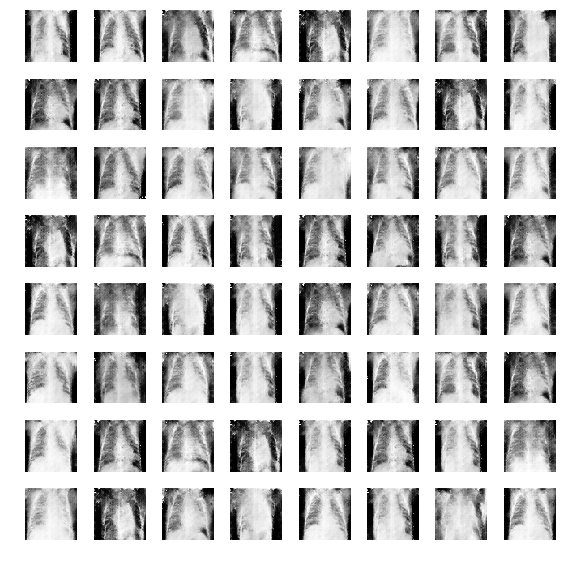

epoch:  216 time:  11.53291654586792 train_G_Loss:  1.4853483 train_D_Loss:  1.3837962 train_acc:  0.8452744
epoch:  217 time:  11.417607545852661 train_G_Loss:  1.958158 train_D_Loss:  1.0080752 train_acc:  0.8549924
epoch:  218 time:  11.386320352554321 train_G_Loss:  1.4483855 train_D_Loss:  1.0783625 train_acc:  0.8481326
epoch:  219 time:  11.374156475067139 train_G_Loss:  2.224288 train_D_Loss:  0.9124679 train_acc:  0.8641387
epoch:  220 time:  11.384077072143555 train_G_Loss:  2.0410054 train_D_Loss:  0.88417524 train_acc:  0.8565168

cv_G_Loss: 2.209174, cv_D_loss: 2.115509, cv_acc: 0.584375

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


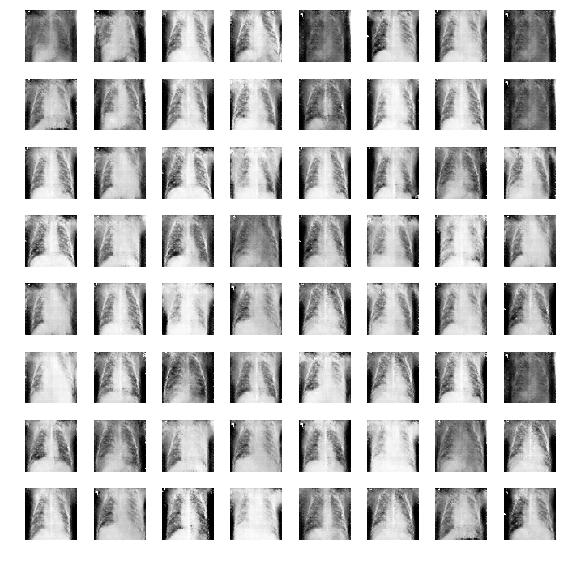

epoch:  221 time:  11.572078466415405 train_G_Loss:  1.4102757 train_D_Loss:  1.3846209 train_acc:  0.8563262
epoch:  222 time:  11.355895757675171 train_G_Loss:  2.2126389 train_D_Loss:  1.3488142 train_acc:  0.8649009
epoch:  223 time:  11.36927080154419 train_G_Loss:  1.591472 train_D_Loss:  1.1394726 train_acc:  0.8675686
epoch:  224 time:  11.358577966690063 train_G_Loss:  1.5432931 train_D_Loss:  1.2802267 train_acc:  0.8624238
epoch:  225 time:  11.347893714904785 train_G_Loss:  1.5421462 train_D_Loss:  0.8532292 train_acc:  0.8641387

cv_G_Loss: 1.326942, cv_D_loss: 1.969111, cv_acc: 0.568750

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


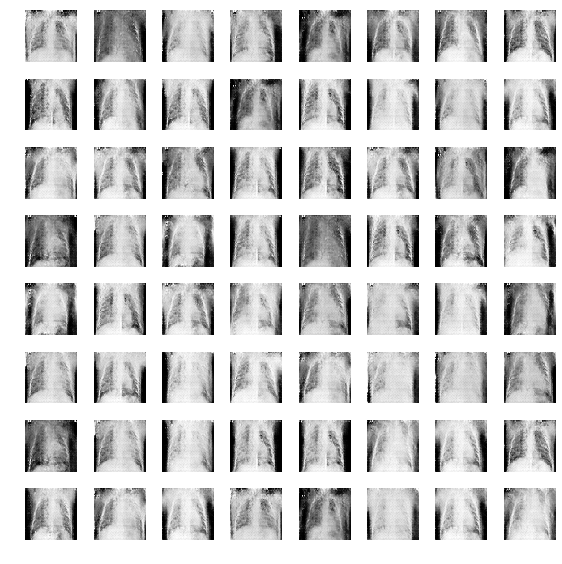

epoch:  226 time:  11.502253293991089 train_G_Loss:  1.600758 train_D_Loss:  1.2144322 train_acc:  0.86108994
epoch:  227 time:  11.336169958114624 train_G_Loss:  1.5458462 train_D_Loss:  1.1963704 train_acc:  0.8589939
epoch:  228 time:  12.366356611251831 train_G_Loss:  1.5481538 train_D_Loss:  1.690464 train_acc:  0.8608994
epoch:  229 time:  11.371898889541626 train_G_Loss:  1.4505045 train_D_Loss:  1.0255938 train_acc:  0.8671875
epoch:  230 time:  11.370867729187012 train_G_Loss:  1.7244745 train_D_Loss:  1.1332773 train_acc:  0.85804117

cv_G_Loss: 1.704464, cv_D_loss: 1.757288, cv_acc: 0.531250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


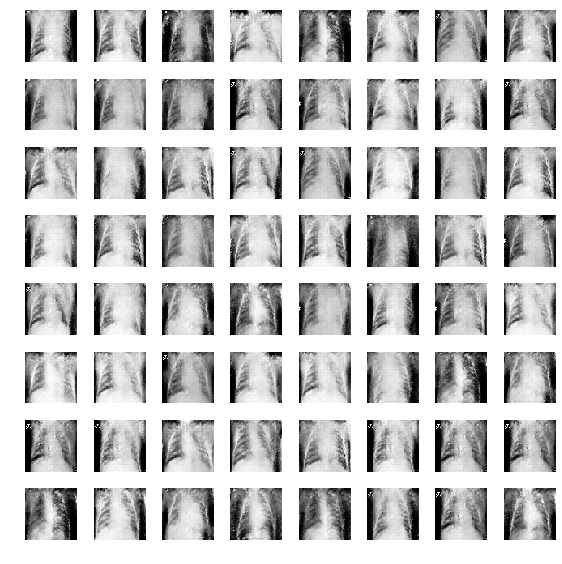

epoch:  231 time:  11.498178958892822 train_G_Loss:  1.5299554 train_D_Loss:  1.2557898 train_acc:  0.84698933
epoch:  232 time:  11.38595175743103 train_G_Loss:  1.721087 train_D_Loss:  0.92151845 train_acc:  0.86070883
epoch:  233 time:  11.378398180007935 train_G_Loss:  2.7204108 train_D_Loss:  0.7654032 train_acc:  0.86775917
epoch:  234 time:  11.375369548797607 train_G_Loss:  1.1053748 train_D_Loss:  1.1145561 train_acc:  0.86451983
epoch:  235 time:  11.388599157333374 train_G_Loss:  1.7557126 train_D_Loss:  1.2991112 train_acc:  0.85804117

cv_G_Loss: 1.638883, cv_D_loss: 1.490710, cv_acc: 0.467187

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


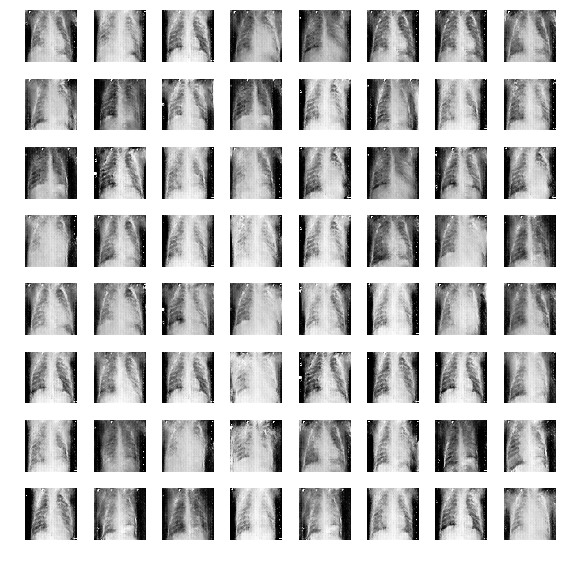

epoch:  236 time:  11.528505325317383 train_G_Loss:  1.6128823 train_D_Loss:  1.0438308 train_acc:  0.86890244
epoch:  237 time:  11.362244367599487 train_G_Loss:  1.4775641 train_D_Loss:  1.1680198 train_acc:  0.8624238
epoch:  238 time:  11.354026556015015 train_G_Loss:  2.015936 train_D_Loss:  1.1095146 train_acc:  0.8633765
epoch:  239 time:  11.379358291625977 train_G_Loss:  1.7949778 train_D_Loss:  1.1352084 train_acc:  0.85918444
epoch:  240 time:  11.39652132987976 train_G_Loss:  1.9693654 train_D_Loss:  0.755521 train_acc:  0.87080795

cv_G_Loss: 1.753260, cv_D_loss: 1.536183, cv_acc: 0.564062

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


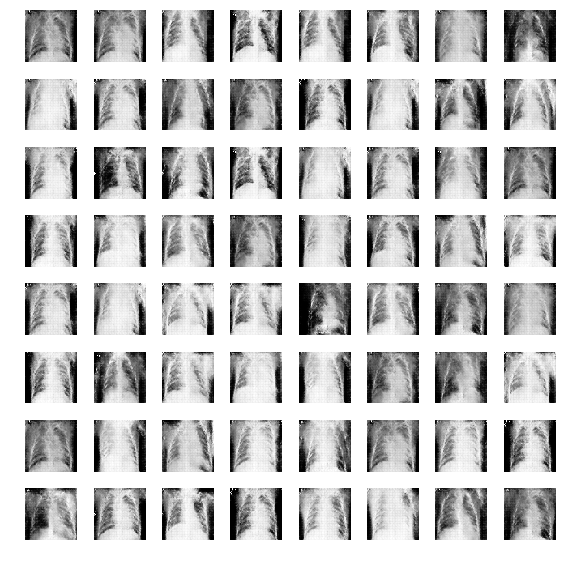

epoch:  241 time:  11.508823871612549 train_G_Loss:  1.8479205 train_D_Loss:  0.677044 train_acc:  0.8675686
epoch:  242 time:  11.356898546218872 train_G_Loss:  1.8565361 train_D_Loss:  0.69615674 train_acc:  0.8702363
epoch:  243 time:  11.368276596069336 train_G_Loss:  1.3365899 train_D_Loss:  1.3811002 train_acc:  0.86928356
epoch:  244 time:  11.394794940948486 train_G_Loss:  1.0240954 train_D_Loss:  1.926146 train_acc:  0.8757622
epoch:  245 time:  11.570024013519287 train_G_Loss:  1.9533631 train_D_Loss:  0.7647246 train_acc:  0.87290394

cv_G_Loss: 1.733226, cv_D_loss: 1.340333, cv_acc: 0.545313

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


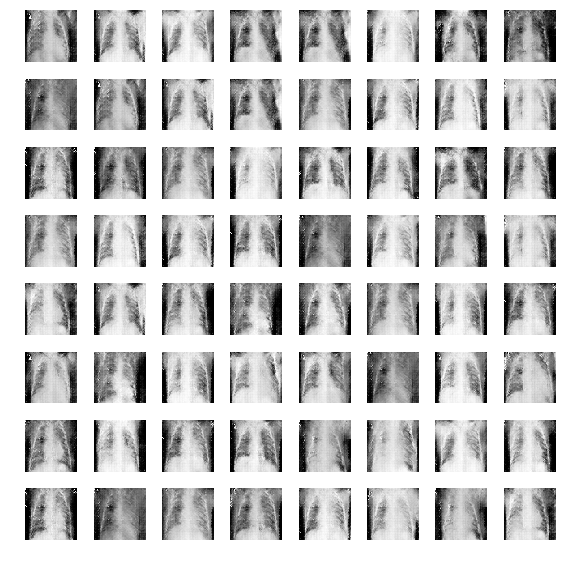

epoch:  246 time:  11.626103162765503 train_G_Loss:  2.321658 train_D_Loss:  0.69956124 train_acc:  0.8702363
epoch:  247 time:  11.41099762916565 train_G_Loss:  1.878158 train_D_Loss:  0.7953848 train_acc:  0.8696646
epoch:  248 time:  11.420440912246704 train_G_Loss:  1.4088166 train_D_Loss:  1.4134122 train_acc:  0.87290394
epoch:  249 time:  11.34546422958374 train_G_Loss:  1.2316984 train_D_Loss:  1.2146103 train_acc:  0.8709985
epoch:  250 time:  11.384687423706055 train_G_Loss:  1.6651877 train_D_Loss:  0.84573257 train_acc:  0.86737806

cv_G_Loss: 1.410956, cv_D_loss: 1.839248, cv_acc: 0.601562

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


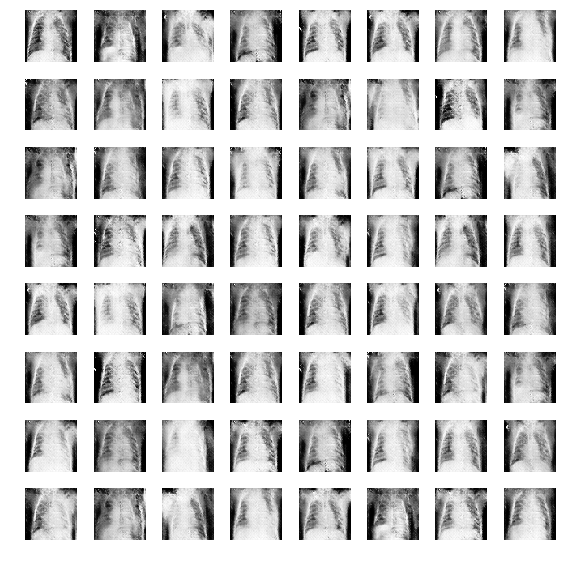

epoch:  251 time:  11.507017135620117 train_G_Loss:  1.7074491 train_D_Loss:  0.9008966 train_acc:  0.8647104
epoch:  252 time:  11.365357160568237 train_G_Loss:  1.6144015 train_D_Loss:  0.9519391 train_acc:  0.855564
epoch:  253 time:  11.3123779296875 train_G_Loss:  2.2082236 train_D_Loss:  1.0053073 train_acc:  0.865282
epoch:  254 time:  11.336418867111206 train_G_Loss:  1.7710438 train_D_Loss:  1.3161061 train_acc:  0.87137955
epoch:  255 time:  11.322588682174683 train_G_Loss:  2.0917335 train_D_Loss:  1.5915323 train_acc:  0.87328506

cv_G_Loss: 2.009722, cv_D_loss: 2.077989, cv_acc: 0.581250

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


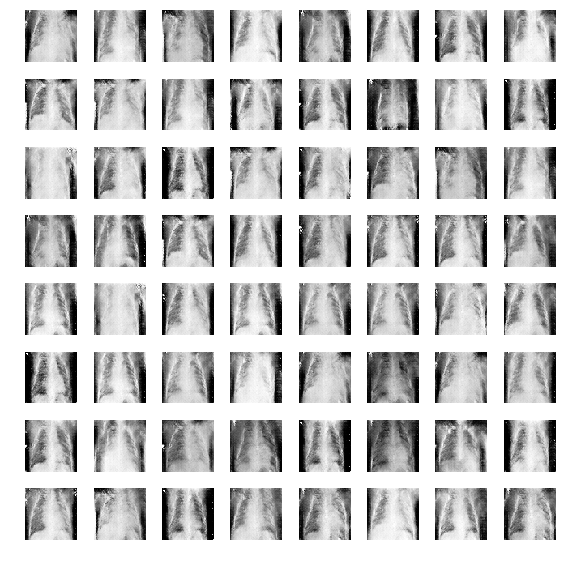

epoch:  256 time:  11.484154462814331 train_G_Loss:  1.4532964 train_D_Loss:  0.9095864 train_acc:  0.87290394
epoch:  257 time:  11.330944538116455 train_G_Loss:  1.7465762 train_D_Loss:  1.1073182 train_acc:  0.86356705
epoch:  258 time:  11.357274770736694 train_G_Loss:  1.6573207 train_D_Loss:  0.94360983 train_acc:  0.87042683
epoch:  259 time:  11.344485521316528 train_G_Loss:  1.5237479 train_D_Loss:  1.5699418 train_acc:  0.87080795
epoch:  260 time:  11.38653826713562 train_G_Loss:  1.3103044 train_D_Loss:  0.790926 train_acc:  0.8730945

cv_G_Loss: 1.412992, cv_D_loss: 2.335306, cv_acc: 0.525000

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


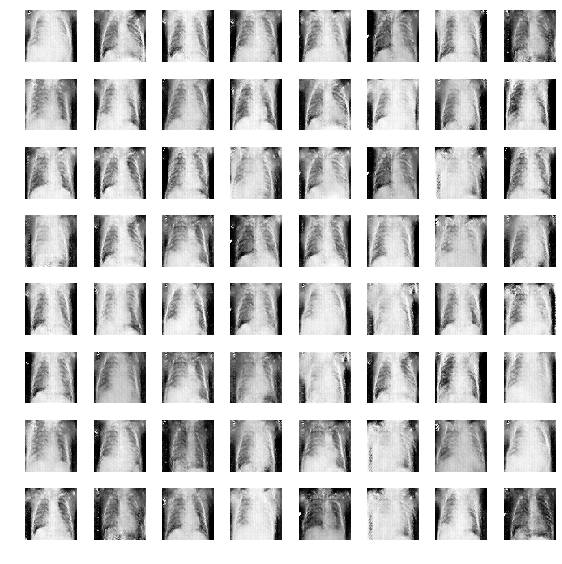

epoch:  261 time:  11.578404426574707 train_G_Loss:  1.5415033 train_D_Loss:  1.3434659 train_acc:  0.8679497
epoch:  262 time:  11.415757417678833 train_G_Loss:  1.2322357 train_D_Loss:  1.4193517 train_acc:  0.87709606
epoch:  263 time:  11.388644695281982 train_G_Loss:  1.7626371 train_D_Loss:  1.0638299 train_acc:  0.8679497
epoch:  264 time:  11.403821468353271 train_G_Loss:  1.1539524 train_D_Loss:  1.0437901 train_acc:  0.8702363
epoch:  265 time:  11.366942882537842 train_G_Loss:  1.7193649 train_D_Loss:  1.0188771 train_acc:  0.8553735

cv_G_Loss: 1.545675, cv_D_loss: 1.719504, cv_acc: 0.559375

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


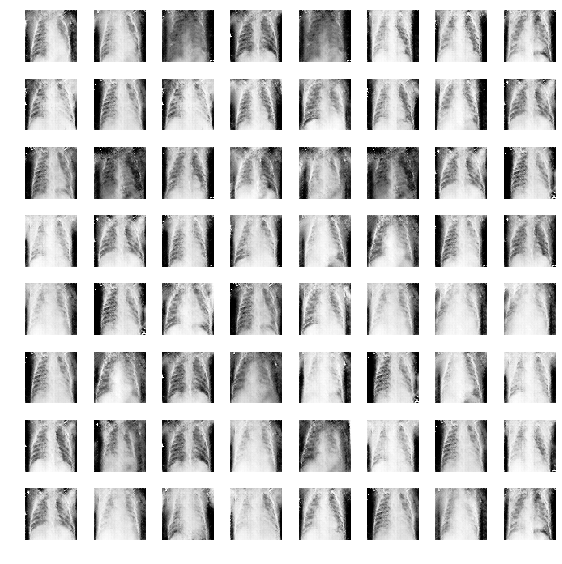

epoch:  266 time:  11.533691883087158 train_G_Loss:  1.7760788 train_D_Loss:  0.8036479 train_acc:  0.87290394
epoch:  267 time:  11.371127605438232 train_G_Loss:  1.7451282 train_D_Loss:  1.8788447 train_acc:  0.8660442
epoch:  268 time:  11.401620388031006 train_G_Loss:  1.5757738 train_D_Loss:  0.8011888 train_acc:  0.8643293
epoch:  269 time:  11.384957075119019 train_G_Loss:  1.1878537 train_D_Loss:  0.784949 train_acc:  0.87233233
epoch:  270 time:  11.36335301399231 train_G_Loss:  1.1980499 train_D_Loss:  1.0176272 train_acc:  0.88262194

cv_G_Loss: 1.185500, cv_D_loss: 1.727802, cv_acc: 0.542188

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


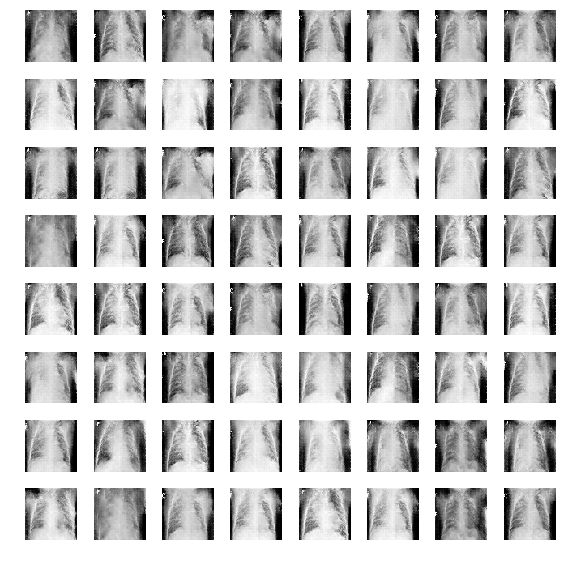

epoch:  271 time:  11.517786979675293 train_G_Loss:  1.7777065 train_D_Loss:  0.7022028 train_acc:  0.86699694
epoch:  272 time:  11.36255693435669 train_G_Loss:  1.71355 train_D_Loss:  1.720511 train_acc:  0.87766767
epoch:  273 time:  11.371742963790894 train_G_Loss:  1.929529 train_D_Loss:  1.4997234 train_acc:  0.8414634
epoch:  274 time:  11.407197952270508 train_G_Loss:  1.4782075 train_D_Loss:  0.98551345 train_acc:  0.86852133
epoch:  275 time:  11.429396629333496 train_G_Loss:  2.105848 train_D_Loss:  0.494874 train_acc:  0.8805259

cv_G_Loss: 1.482601, cv_D_loss: 1.949997, cv_acc: 0.534375

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


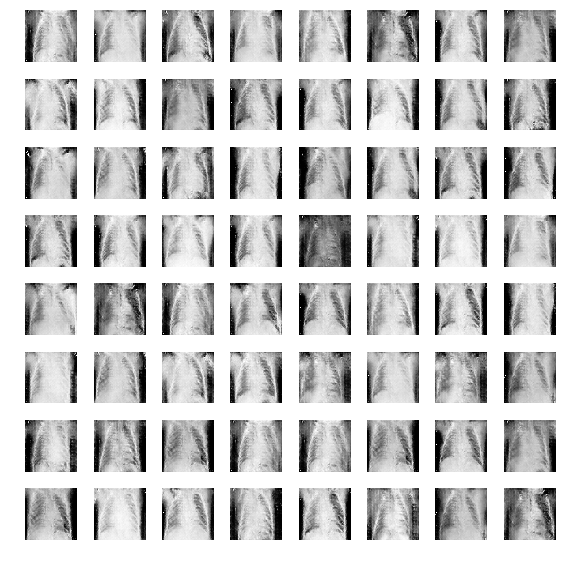

epoch:  276 time:  11.562179327011108 train_G_Loss:  1.9129817 train_D_Loss:  0.7504894 train_acc:  0.87290394
epoch:  277 time:  11.432536602020264 train_G_Loss:  2.121855 train_D_Loss:  0.7167102 train_acc:  0.88929117
epoch:  278 time:  11.43109130859375 train_G_Loss:  2.0472236 train_D_Loss:  0.8615063 train_acc:  0.8660442
epoch:  279 time:  11.41772723197937 train_G_Loss:  1.7897542 train_D_Loss:  0.6765007 train_acc:  0.8702363
epoch:  280 time:  11.37474274635315 train_G_Loss:  1.5133638 train_D_Loss:  0.8702618 train_acc:  0.890625

cv_G_Loss: 1.602990, cv_D_loss: 1.508585, cv_acc: 0.512500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


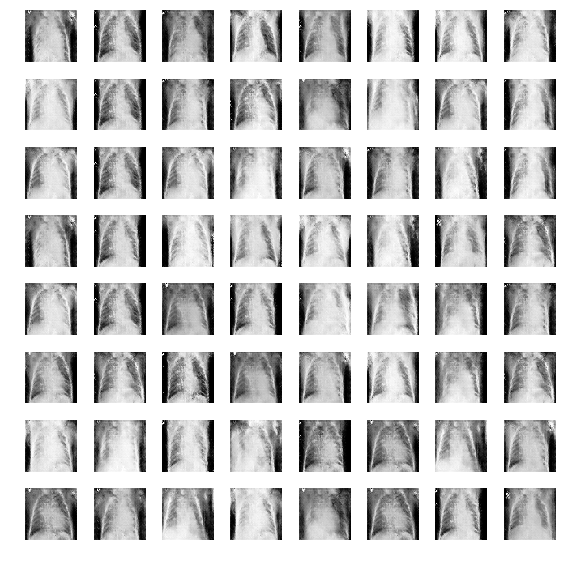

epoch:  281 time:  11.515258550643921 train_G_Loss:  1.5095067 train_D_Loss:  0.9693669 train_acc:  0.88891006
epoch:  282 time:  11.35538911819458 train_G_Loss:  1.6702666 train_D_Loss:  1.003144 train_acc:  0.8805259
epoch:  283 time:  11.365589380264282 train_G_Loss:  1.2321566 train_D_Loss:  1.0700241 train_acc:  0.8887195
epoch:  284 time:  11.376636028289795 train_G_Loss:  2.2298305 train_D_Loss:  1.1552924 train_acc:  0.87557167
epoch:  285 time:  11.397259712219238 train_G_Loss:  1.7757096 train_D_Loss:  1.5350038 train_acc:  0.8719512

cv_G_Loss: 1.035161, cv_D_loss: 2.245715, cv_acc: 0.517187

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


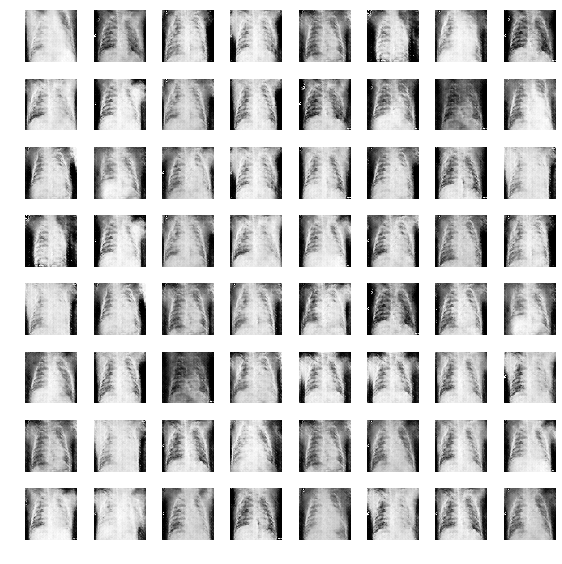

epoch:  286 time:  11.588407039642334 train_G_Loss:  1.9630384 train_D_Loss:  0.7197885 train_acc:  0.8839558
epoch:  287 time:  11.445568799972534 train_G_Loss:  1.6103619 train_D_Loss:  1.1119715 train_acc:  0.8803354
epoch:  288 time:  11.35760760307312 train_G_Loss:  1.6169345 train_D_Loss:  1.7725288 train_acc:  0.8772866
epoch:  289 time:  11.361266851425171 train_G_Loss:  2.682608 train_D_Loss:  0.4926663 train_acc:  0.88014483
epoch:  290 time:  11.357555150985718 train_G_Loss:  1.8023168 train_D_Loss:  0.99514776 train_acc:  0.87919205

cv_G_Loss: 2.047284, cv_D_loss: 1.454729, cv_acc: 0.504687

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


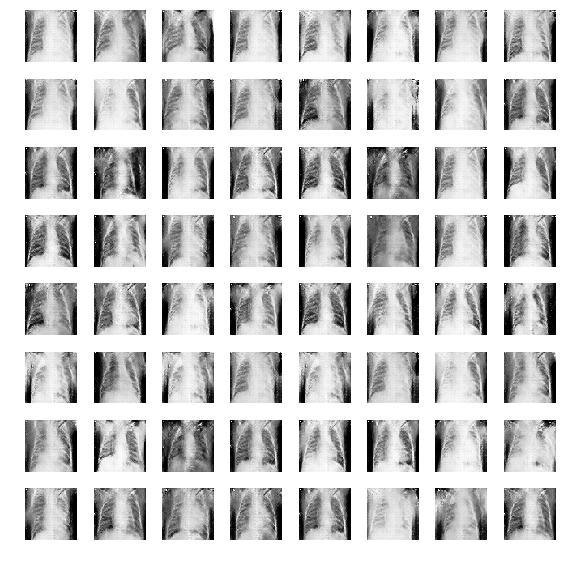

epoch:  291 time:  11.553375720977783 train_G_Loss:  1.4773514 train_D_Loss:  1.204548 train_acc:  0.8862424
epoch:  292 time:  11.378629684448242 train_G_Loss:  1.9947633 train_D_Loss:  1.0404619 train_acc:  0.8715701
epoch:  293 time:  11.34327483177185 train_G_Loss:  2.0371974 train_D_Loss:  0.8405051 train_acc:  0.8852896
epoch:  294 time:  11.332880973815918 train_G_Loss:  1.6644261 train_D_Loss:  1.4696292 train_acc:  0.8812881
epoch:  295 time:  11.372563362121582 train_G_Loss:  1.3946956 train_D_Loss:  0.94296896 train_acc:  0.8803354

cv_G_Loss: 1.656001, cv_D_loss: 1.411182, cv_acc: 0.537500

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


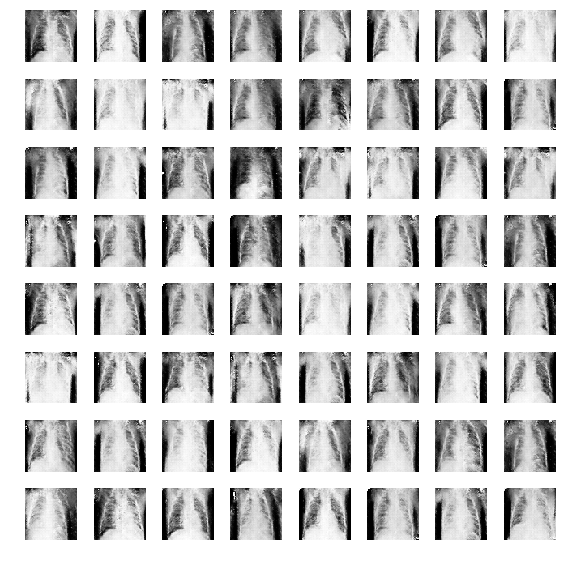

epoch:  296 time:  11.511403799057007 train_G_Loss:  1.3509083 train_D_Loss:  1.461858 train_acc:  0.878811
epoch:  297 time:  11.330273151397705 train_G_Loss:  1.4011029 train_D_Loss:  1.167065 train_acc:  0.896532
epoch:  298 time:  11.357856273651123 train_G_Loss:  1.7256324 train_D_Loss:  1.2038157 train_acc:  0.88452744
epoch:  299 time:  11.507203578948975 train_G_Loss:  1.6884505 train_D_Loss:  1.2597711 train_acc:  0.87709606
epoch:  300 time:  11.544647216796875 train_G_Loss:  2.0825522 train_D_Loss:  0.59947586 train_acc:  0.8769055

cv_G_Loss: 1.614336, cv_D_loss: 1.989383, cv_acc: 0.507812

Model saved in file: gdrive/My Drive/gan/pneu/model_Jan17/gan_pneu_model.ckpt


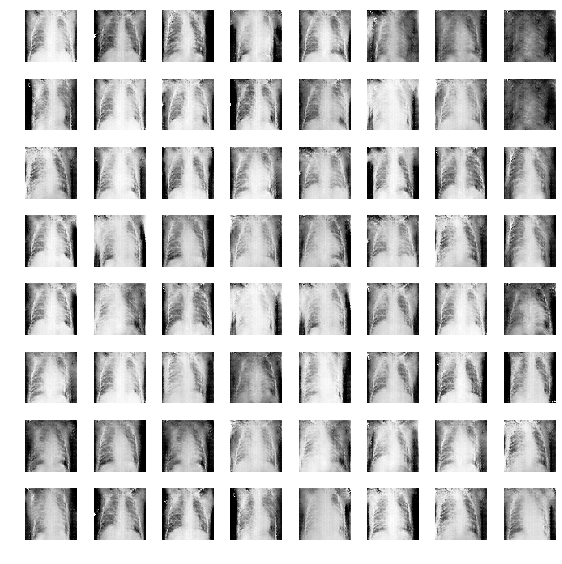

In [116]:
batch_size = 64
prev_epoch = -1
epochs = 301

def train_model(batch_size, epochs, prev_epoch=1):
  #Initialize outputs
  train_D_losses, train_G_losses, train_Accs = [], [], []
  cv_D_losses, cv_G_losses, cv_Accs = [], [], []

  #reset default graph
  tf.reset_default_graph()

  #Graph inputs
  x = tf.placeholder(tf.float32, name = 'x', shape = [None, x_height, x_width, num_channels])
  label = tf.placeholder(tf.float32, name = 'label', shape = [None, num_classes])
  labeled_mask = tf.placeholder(tf.float32, name = 'labeled_mask', shape = [None])
  z = tf.placeholder(tf.float32, name = 'z', shape = [None, latent_size])
  dropout_rate = tf.placeholder(tf.float32, name = 'dropout_rate')
  is_training = tf.placeholder(tf.bool, name = 'is_training')
  G_learning_rate = tf.placeholder(tf.float32, name = 'G_learning_rate')
  D_learning_rate = tf.placeholder(tf.float32, name = 'D_learning_rate')


  ##Define the model
  model = build_model(x, z, label, dropout_rate, is_training, print_summary = True)
    
    
  D_real_features, D_real_logit, D_real_prob, \
  D_fake_features, D_fake_logit, D_fake_prob, \
  fake_data = model #

  #Results
  extended_label = prepare_labels(label)

  loss_acc  = loss_accuracy(D_real_features, D_real_logit, D_real_prob,
                          D_fake_features, D_fake_logit, D_fake_prob,
                              extended_label, labeled_mask)

  _, _, _, D_L, G_L, accuracy = loss_acc # D_loss, G_loss, accuracy 
  D_optimizer, G_optimizer = optimizer(D_L, G_L, G_learning_rate, D_learning_rate) 


  # Initialize the variables (i.e. assign their default value)
  init = tf.global_variables_initializer()

  # 'Saver' op to save and restore all the variables
  saver = tf.train.Saver()


  train_images = dataset['x_train']
  train_labels = dataset['y_train']
  test_images = dataset['x_test']
  test_labels = dataset['y_test']


  # Running first session
  print("Training...")
  with tf.Session() as sess:
    # Run the initializer
    sess.run(init)
    
    if prev_epoch > 0:
      # Restore model weights from previously saved model if any
      saver.restore(sess, model_path)
      print("Model restored at epoch %d from file: %s" %(prev_epoch, model_path))

    for epoch in range(prev_epoch+1, epochs):
      t_total = 0
      train_size = train_labels.shape[0]
      n_iter = int(train_size / batch_size) +  1 
      st_ind = 0
      train_acc = []
      
      for iter in range(int(train_images.shape[0] / batch_size) + 1):
        t_start = time.time()
                
        if iter == n_iter - 1:
            st_ind = train_size - batch_size - 1
            idx = np.random.randint(st_ind, train_size, batch_size)
        else:
            last_ind = st_ind + batch_size
            idx = np.random.randint(st_ind, last_ind, batch_size)
            st_ind += batch_size
        #print(iter, idx)
  
        #idx = np.random.randint(0, train_images.shape[0], batch_size)
        batch_images = train_images[idx]
        batch_labels = train_labels[idx]
        batch = (batch_images, batch_labels)
                
        batch_z = np.random.uniform(-1.0, 1.0, size = (batch_size, latent_size))
        mask = get_labled_mask(labeled_rate, batch_size)
                
        train_feed_dictionary = {x:  normalize(batch[0]),
                                         z: batch_z,
                                         label: batch[1],
                                         labeled_mask: mask,
                                         dropout_rate: 0.2,
                                         G_learning_rate: 0.0002,
                                         D_learning_rate: 0.0002,
                                         is_training: True}

        D_optimizer.run(feed_dict = train_feed_dictionary)
        G_optimizer.run(feed_dict = train_feed_dictionary)

        train_D_loss = D_L.eval(feed_dict = train_feed_dictionary)
        train_G_loss = G_L.eval(feed_dict = train_feed_dictionary)
        train_accuracy = accuracy.eval(feed_dict = train_feed_dictionary)
        t_total += (time.time() - t_start)
        
        train_acc.append(train_accuracy)
        
      train_accuracy = np.mean(train_acc)          
      #pdb.set_trace()
      
      log_loss_acc(log_path, epoch, train_D_loss, train_G_loss, train_accuracy,
                         train_D_loss, train_G_loss, train_accuracy, log_mode = 'w')
      print('epoch: ', epoch, 'time: ',t_total, 'train_G_Loss: ',train_G_loss, 'train_D_Loss: ', 
                  train_D_loss, 'train_acc: ', train_accuracy)
      
      #print("Cross validation!")
      if epoch % 5 == 0:
        # Cross-Validation
        cv_size = test_labels.shape[0]
        n_it = int(cv_size / batch_size) +  1 
        st_ind = 0
        cv_acc = []
      
        for test_it in range(n_it):
          if test_it == n_it - 1:
            st_ind = cv_size - batch_size - 1
            idx = np.random.randint(st_ind, cv_size, batch_size)
          else:
            last_ind = st_ind + batch_size
            idx = np.random.randint(st_ind, last_ind, batch_size)
            st_ind += batch_size
          #print(test_it, idx)
  
          batch_images = test_images[idx]
          batch_labels = test_labels[idx]
          test_batch = (batch_images, batch_labels)
        
          cv_batch_z = np.random.uniform(-1.0, 1.0, size = (batch_size, latent_size))
          mask = get_labled_mask(1, batch_size)
          cv_feed_dictionary = {x: normalize(test_batch[0]),
                                  z: cv_batch_z,
                                  label: test_batch[1],
                                  labeled_mask: mask,
                                  dropout_rate: 0.0,
                                  is_training: False}

          cv_D_loss = D_L.eval(feed_dict = cv_feed_dictionary)
          cv_G_loss = G_L.eval(feed_dict = cv_feed_dictionary)
          cv_accuracy = accuracy.eval(feed_dict = cv_feed_dictionary)
          cv_acc.append(cv_accuracy)
      
        cv_accuracy = np.mean(cv_acc)
      
        
        print('\ncv_G_Loss: %f, cv_D_loss: %f, cv_acc: %f\n' %(cv_G_loss,
                                                                 cv_D_loss,
                                                                 cv_accuracy))
            
        #save_model_on_imporvemnet(model_path, sess, cv_accuracy, cv_Accs)
            
      
        #if cv_Accs == [] or cv_accuracy > np.max(cv_Accs):
        save_path = saver.save(sess, model_path)
        print("Model saved in file: %s" % save_path)
        
        fakes = fake_data.eval(feed_dict = train_feed_dictionary)
        rescaled_fakes = (fakes + 1.0)/2.0
        plot_fake_data(rescaled_fakes, [8, 8])
        fig = plot(rescaled_fakes[:64])
        plt.savefig((save_to + 'G@epoch{}.png').format(str(epoch).zfill(3)), bbox_inches = "tight")
        plt.close()
      
        cv_D_losses.append(cv_D_loss)
        cv_G_losses.append(cv_G_loss)
        cv_Accs.append(cv_accuracy)